<a href="https://colab.research.google.com/github/CesarAugusto88/dissertation/blob/main/Test_Landslides_Petropolis_Merged_patches_predict.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<h2 style="text-align:center">
Instituto Nacional de Pesquisas Espaciais, INPE <br>
Pós-Graduação em Computação Aplicada, CAP <br>

Autor: Cesar Augusto de Moraes Costa

Data: 01/12/2023

#1: Introdução: Notebook para teste de inferência do modelo U-Net para a área de estudo Petrópolis - RJ.

### O objetivo do projeto foi utilizar a arquitetura U-Net treinada para o domínio de desastre de deslizamentos de terra ocorrido em São Sebastião, litoral norte de São Paulo, onde ocorreu diversos escorregamentos de terra, conseguindo obter um dataset balanceado, para classificar os dados de deslizamentos ocorrido em Petrópolis.

## 2: Configurações iniciais.

### Carregar imagens contidas no drive


In [ ]:
# # Download de arquivos
# # 2021
# !gdown --id --folder 1iCCAFv6IEzn8Jc3Qfx0A3-WMjMRswmeq -q
# # 2022
# !gdown --id --folder 1ATgkq4txtQW69Q3My_pog00qDGjq2tsm -q

In [ ]:
import requests
import zipfile
import io

# URL direta para download do arquivo zip
url = "https://github.com/CesarAugusto88/databases_dissertation/raw/main/databases/inference/recortes_imagem_petropolis.zip"

# Baixar o conteúdo do arquivo zip
response = requests.get(url)

# Verificar se a solicitação foi bem-sucedida
if response.status_code == 200:
    # Criar um objeto de arquivo zip
    zip_file = zipfile.ZipFile(io.BytesIO(response.content))

    # Extrair o conteúdo para um diretório
    zip_file.extractall("recortes_imagem_petropolis")
else:
    print(f"Erro ao baixar o arquivo. Código de status: {response.status_code}")


In [ ]:
!mv /content/recortes_imagem_petropolis/recortes_imagem/recortes_20210328 /content/
!mv /content/recortes_imagem_petropolis/recortes_imagem/recortes_20220304 /content/

In [ ]:
# Instalar pacote Rasterio
!pip install rasterio -q

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.6/20.6 MB 32.4 MB/s eta 0:00:00


## 3: Imagens 2021 - Carregamento de imagens raster, sistema de referência, transformação afim, usando os pacote gdal e rasterio para Python [1].

In [ ]:
from osgeo import gdal
# IMAGES 2021
p0 = '/content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b0.tif'
img0 = gdal.Open(p0)
r0 = img0.GetGeoTransform()
print(r0)
p1 = '/content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b1.tif'
img1 = gdal.Open(p1)
r1 = img1.GetGeoTransform()
print(r1)
p2 = '/content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b2.tif'
img2 = gdal.Open(p2)
r2 = img2.GetGeoTransform()
print(r2)
p3 = '/content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b3.tif'
img3 = gdal.Open(p3)
r3 = img3.GetGeoTransform()
print(r3)
p4 = '/content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b4.tif'
img4 = gdal.Open(p4)
r4 = img4.GetGeoTransform()
print(r4)

(686716.0, 2.0, 0.0, 7509824.0, 0.0, -2.0)
(686712.0, 8.0, 0.0, 7509826.0, 0.0, -8.0)
(686712.0, 8.0, 0.0, 7509826.0, 0.0, -8.0)
(686712.0, 8.0, 0.0, 7509826.0, 0.0, -8.0)
(686712.0, 8.0, 0.0, 7509826.0, 0.0, -8.0)


In [ ]:
import rasterio
from pathlib import Path
import matplotlib.pyplot as plt
import numpy as np
from osgeo import gdal
gdal.__version__,rasterio.__version__

('3.4.3', '1.3.9')

In [ ]:
def load_cbers_image(img_folder, bands):
    # initialize the dictionaries
    image = {}
    ds = {}

    path = Path(img_folder)

    # loop through the given bands to load
    for band in bands:
        # considering the cbers images end with *_SR_B#.TIF, we will use it to locate the correct file
        file = next(path.glob(f'*{band}.tif'))
        print(f'Opening file {file}')
        ds.update({band: rasterio.open(file)})
        image.update({band: ds[band].read(1)})

    return image, ds



Opening file /content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b0.tif
Opening file /content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b1.tif
Opening file /content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b2.tif
Opening file /content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b3.tif
Opening file /content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b4.tif


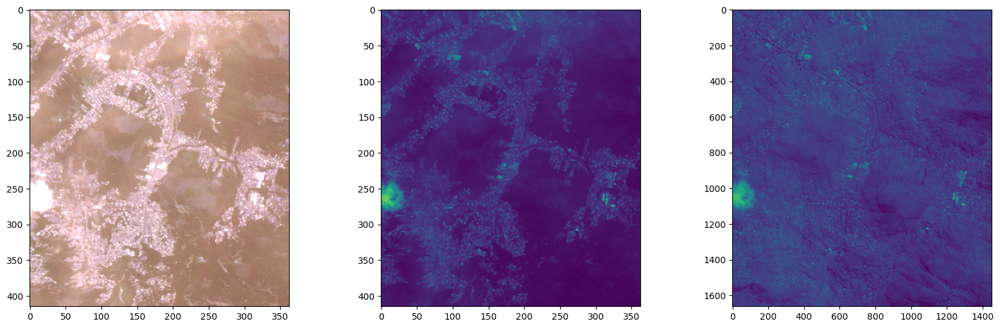

In [ ]:
# load the image
img, image_ds = load_cbers_image('/content/recortes_20210328/',
                                   ['CBERS_4A_WPM_20210328_198_141_L4_b0',
                                    'CBERS_4A_WPM_20210328_198_141_L4_b1',
                                    'CBERS_4A_WPM_20210328_198_141_L4_b2',
                                    'CBERS_4A_WPM_20210328_198_141_L4_b3',
                                    'CBERS_4A_WPM_20210328_198_141_L4_b4'])
# create image - BGRNIR
BGRNIR = np.stack([img['CBERS_4A_WPM_20210328_198_141_L4_b1'],
                    img['CBERS_4A_WPM_20210328_198_141_L4_b2'],
                    img['CBERS_4A_WPM_20210328_198_141_L4_b3'],
                    img['CBERS_4A_WPM_20210328_198_141_L4_b4']], axis=2)
BGRNIR = BGRNIR / BGRNIR.max()

# load bands 1 and 0
b0_ds = rasterio.open('/content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b0.tif')
b1_ds = rasterio.open('/content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b1.tif')

b0_array = b0_ds.read(1)
b1_array = b1_ds.read(1)

# Plot the 3 images
fig, ax = plt.subplots(1, 3, figsize=(20, 6))
ax[0].imshow(BGRNIR*3)

ax[1].imshow(b1_array);
ax[2].imshow(b0_array)

In [ ]:
print(BGRNIR.shape, b1_array.shape, b0_array.shape)

(415, 363, 4) (415, 363) (1662, 1452)


###3.1: Sistema de Referência de Coordenadas CRS

In [ ]:
print('Band Green B2: \n', image_ds['CBERS_4A_WPM_20210328_198_141_L4_b2'].profile)
print('Band Blue B1: \n', b1_ds.profile)
print('Band Pan  B0: \n', b0_ds.profile)

Band Green B2: 
 {'driver': 'GTiff', 'dtype': 'int16', 'nodata': 0.0, 'width': 363, 'height': 415, 'count': 1, 'crs': CRS.from_epsg(32723), 'transform': Affine(8.0, 0.0, 686712.0,
       0.0, -8.0, 7509826.0), 'blockysize': 11, 'tiled': False, 'interleave': 'band'}
Band Blue B1: 
 {'driver': 'GTiff', 'dtype': 'int16', 'nodata': 0.0, 'width': 363, 'height': 415, 'count': 1, 'crs': CRS.from_epsg(32723), 'transform': Affine(8.0, 0.0, 686712.0,
       0.0, -8.0, 7509826.0), 'blockysize': 11, 'tiled': False, 'interleave': 'band'}
Band Pan  B0: 
 {'driver': 'GTiff', 'dtype': 'int16', 'nodata': 0.0, 'width': 1452, 'height': 1662, 'count': 1, 'crs': CRS.from_epsg(32723), 'transform': Affine(2.0, 0.0, 686716.0,
       0.0, -2.0, 7509824.0), 'blockysize': 2, 'tiled': False, 'interleave': 'band'}


###3.2: Salvar imagem com sistema de referências
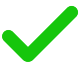

In [ ]:
from osgeo import gdal
dataset = gdal.Open("/content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b2.tif", gdal.GA_ReadOnly)
type(dataset)

osgeo.gdal.Dataset

In [ ]:
GT = dataset.GetGeoTransform()

print(type(BGRNIR))

dst_crs='EPSG:32723'
print(BGRNIR.shape)

<class 'numpy.ndarray'>
(415, 363, 4)


In [ ]:
saida2021BGRNIR = np.float32(BGRNIR)

In [ ]:
print(GT)

(686712.0, 8.0, 0.0, 7509826.0, 0.0, -8.0)


In [ ]:
from affine import Affine
transf = (686712.0, 8.0, 0.0, 7509826.0, 0.0, -8.0)
af_transf = Affine.from_gdal(*transf)
print(af_transf)

| 8.00, 0.00, 686712.00|
| 0.00,-8.00, 7509826.00|
| 0.00, 0.00, 1.00|


In [ ]:
saida2021BGRNIR.shape

(415, 363, 4)

In [ ]:
print(saida2021BGRNIR.shape[0], saida2021BGRNIR.shape[1], saida2021BGRNIR.shape[2])

415 363 4


In [ ]:
with rasterio.open('image2021.tif', 'w',
                  driver='GTiff',
                  height=saida2021BGRNIR.shape[0],
                  width=saida2021BGRNIR.shape[1],
                  count=saida2021BGRNIR.shape[2],
                  dtype=np.float32,
                  crs=dst_crs,
                  transform=af_transf) as dst:
    # If saida2021BGRNIR is in (y, x, z) order (rows, cols, bands)
    dst.write(np.moveaxis(saida2021BGRNIR, [0, 1, 2], [1, 2, 0]))

In [ ]:
img = gdal.Open('/content/image2021.tif')
r = img.GetGeoTransform()
print(r)

(686712.0, 8.0, 0.0, 7509826.0, 0.0, -8.0)


(4, 415, 363) (415, 363, 4)


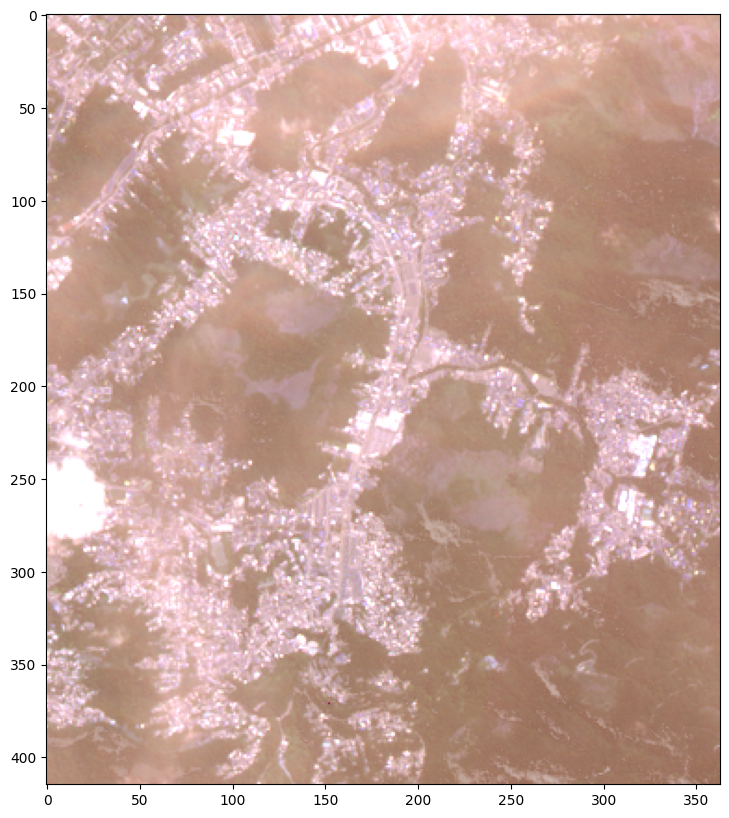

In [ ]:
img_array = rasterio.open('/content/image2021.tif').read()
img_array_ = np.transpose(img_array, (1, 2, 0))
print(img_array.shape, img_array_.shape)
plt.figure(figsize=(10, 10))
plt.imshow(img_array_*3);

###3.3 Criando pansharpening

In [ ]:
!pip install -q gdal-utils

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 337.9/337.9 kB 5.0 MB/s eta 0:00:00


In [ ]:
# pansharpening
# For GDAL >= 3.3:
# from osgeo.osgeo_utils import gdal_pansharpen
from osgeo_utils.gdal_pansharpen import gdal_pansharpen
gdal_pansharpen(
    pan_name='/content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b0.tif',
    spectral_names=['/content/image2021.tif'],
    band_nums=[1, 2, 3, 4],
    dst_filename='output_pansharpened2021BGRNIR.tif')

0

In [ ]:
img_array = rasterio.open('/content/output_pansharpened2021BGRNIR.tif').read()
# img_array_ = np.transpose(img_array, (1, 2, 0))
# print(img_array.shape, img_array_.shape)
print(img_array.shape)
# plt.figure(figsize=(10, 10))
# plt.imshow(img_array_);

(4, 1662, 1452)


(1662, 1452, 4)


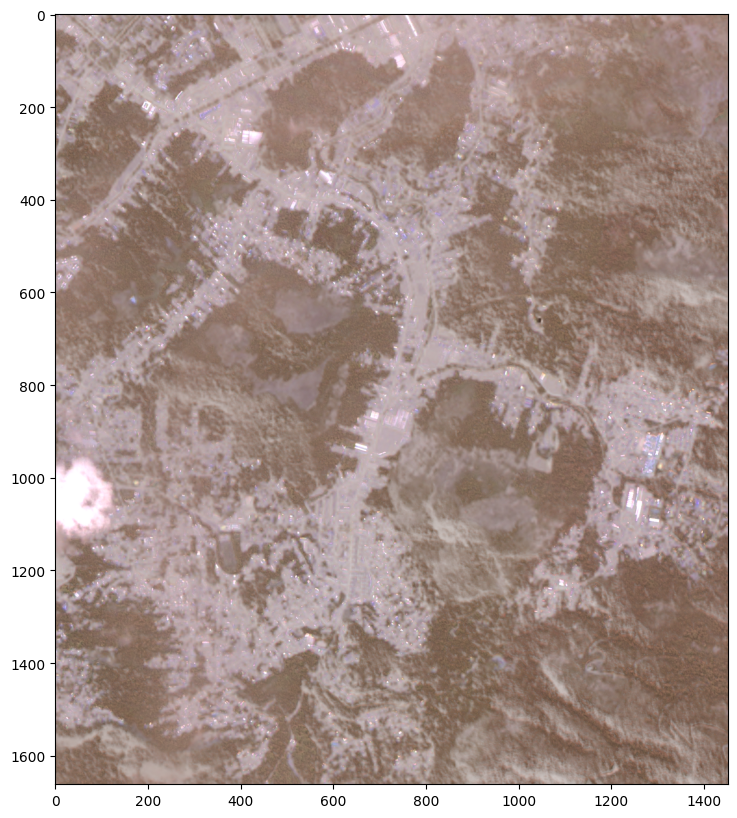

In [ ]:
pansharp2021 = rasterio.open('/content/output_pansharpened2021BGRNIR.tif').read()

# pansharp2021 = np.stack([pansharp2021[0],pansharp2021[1],
#                   pansharp2021[2],pansharp2021[3]], axis=2)
# pansharp2021 = np.stack(pansharp2021, axis=2)
pansharp2021 = np.dstack(pansharp2021)

print(pansharp2021.shape)

rgb2021_pansharp = pansharp2021 / pansharp2021.max()
plt.figure(figsize=(10, 10))
plt.imshow(rgb2021_pansharp*3)

In [ ]:
dataset2021 = gdal.Open("/content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b0.tif", gdal.GA_ReadOnly)
GT2021 = dataset2021.GetGeoTransform()
print(GT2021)

(686716.0, 2.0, 0.0, 7509824.0, 0.0, -2.0)


#####2.3.1: Transf Affine 2021 and 2022

In [ ]:
from affine import Affine
transf2021_2022 = (686716.0, 2.0, 0.0, 7509824.0, 0.0, -2.0)
af_transf2021_2022 = Affine.from_gdal(*transf2021_2022)
print(af_transf2021_2022)

| 2.00, 0.00, 686716.00|
| 0.00,-2.00, 7509824.00|
| 0.00, 0.00, 1.00|


###3.4: Mostrando Imagens: RGB, RGNIR e Pansharpening

Opening file /content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b1.tif
Opening file /content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b2.tif
Opening file /content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b3.tif
Opening file /content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b1.tif
Opening file /content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b2.tif
Opening file /content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b3.tif
Opening file /content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b4.tif


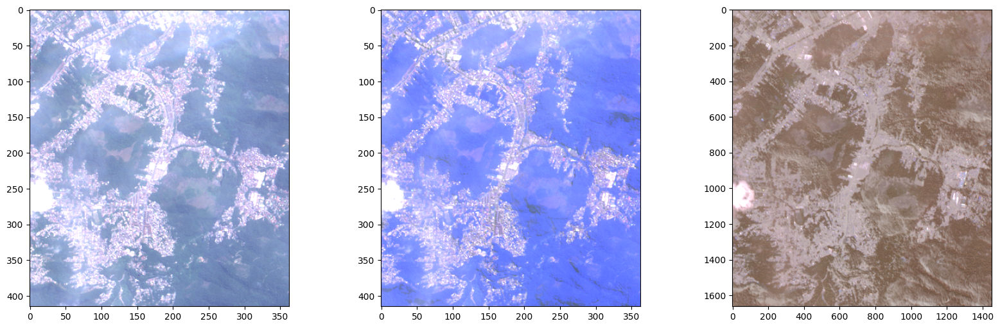

In [ ]:
# load the image
img, image_ds = load_cbers_image('/content/recortes_20210328/',
                                   ['CBERS_4A_WPM_20210328_198_141_L4_b1',
                                    'CBERS_4A_WPM_20210328_198_141_L4_b2',
                                    'CBERS_4A_WPM_20210328_198_141_L4_b3'])
# create the RGB for the image
rgb = np.stack([img['CBERS_4A_WPM_20210328_198_141_L4_b3'],
                img['CBERS_4A_WPM_20210328_198_141_L4_b2'],
                img['CBERS_4A_WPM_20210328_198_141_L4_b1']], axis=2)
rgb = rgb / rgb.max()

# load the image
img_rgbnir, image_rgbnir_ds = load_cbers_image('/content/recortes_20210328/',
                                   ['CBERS_4A_WPM_20210328_198_141_L4_b1',
                                    'CBERS_4A_WPM_20210328_198_141_L4_b2',
                                    'CBERS_4A_WPM_20210328_198_141_L4_b3',
                                    'CBERS_4A_WPM_20210328_198_141_L4_b4'])
# create the RG NIR for the image
rg_nir = np.stack([img_rgbnir['CBERS_4A_WPM_20210328_198_141_L4_b3'],
                    img_rgbnir['CBERS_4A_WPM_20210328_198_141_L4_b2'],
                    img_rgbnir['CBERS_4A_WPM_20210328_198_141_L4_b4']], axis=2)
rg_nir = rg_nir / rg_nir.max()

# load image

pansharp = rasterio.open('/content/output_pansharpened2021BGRNIR.tif').read()
pansharp = np.dstack(pansharp)
pansharp = pansharp / pansharp.max()
# print(pansharp[1])
# Plot the 3 images
fig, ax = plt.subplots(1, 3, figsize=(20, 6));
ax[0].imshow(rgb*3)
ax[1].imshow(rg_nir*3)
ax[2].imshow(pansharp*3);

In [ ]:
print(rgb.shape, rg_nir.shape, pansharp.shape)

(415, 363, 3) (415, 363, 3) (1662, 1452, 4)


##4: Imagens 2022 - Carregamento de imagens raster, sistema de referência, transformação afim, usando os pacote gdal e rasterio para Python [1].

In [ ]:
from osgeo import gdal
# IMAGES 2022
p0 = '/content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b0.tif'
img0 = gdal.Open(p0)
r0 = img0.GetGeoTransform()
print(r0)
p1 = '/content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b1.tif'
img1 = gdal.Open(p1)
r1 = img1.GetGeoTransform()
print(r1)
p2 = '/content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b2.tif'
img2 = gdal.Open(p2)
r2 = img2.GetGeoTransform()
print(r2)
p3 = '/content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b3.tif'
img3 = gdal.Open(p3)
r3 = img3.GetGeoTransform()
print(r3)
p4 = '/content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b4.tif'
img4 = gdal.Open(p4)
r4 = img4.GetGeoTransform()
print(r4)

(686714.0, 2.0, 0.0, 7509822.0, 0.0, -2.0)
(686714.0, 8.0, 0.0, 7509822.0, 0.0, -8.0)
(686714.0, 8.0, 0.0, 7509822.0, 0.0, -8.0)
(686714.0, 8.0, 0.0, 7509822.0, 0.0, -8.0)
(686714.0, 8.0, 0.0, 7509822.0, 0.0, -8.0)


Opening file /content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b1.tif
Opening file /content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b2.tif
Opening file /content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b3.tif


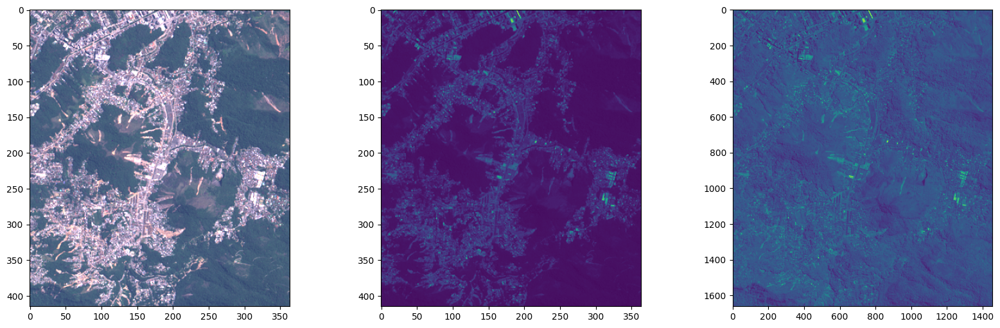

In [ ]:
# load the image
img2022, image2022_ds = load_cbers_image('/content/recortes_20220304/',
                                   ['cbers4a_wpm_20220304_198_141_l4_b1',
                                    'cbers4a_wpm_20220304_198_141_l4_b2',
                                    'cbers4a_wpm_20220304_198_141_l4_b3'])
# create the RGB for the image
rgb2022 = np.stack([img2022['cbers4a_wpm_20220304_198_141_l4_b3'],
                img2022['cbers4a_wpm_20220304_198_141_l4_b2'],
                img2022['cbers4a_wpm_20220304_198_141_l4_b1']], axis=2)
rgb2022 = rgb2022 / rgb2022.max()

# load bands 1 and 0
b0_2022_ds = rasterio.open('/content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b0.tif')
b1_2022_ds = rasterio.open('/content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b1.tif')

b0_2022_array = b0_2022_ds.read(1)
b1_2022_array = b1_2022_ds.read(1)

# Plot the 3 images
fig, ax = plt.subplots(1, 3, figsize=(20, 6));
ax[0].imshow(rgb2022*3)

ax[1].imshow(b1_2022_array);
ax[2].imshow(b0_2022_array)

Opening file /content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b0.tif
Opening file /content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b1.tif
Opening file /content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b2.tif
Opening file /content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b3.tif
Opening file /content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b4.tif


(-0.5, 1454.5, 1661.5, -0.5)

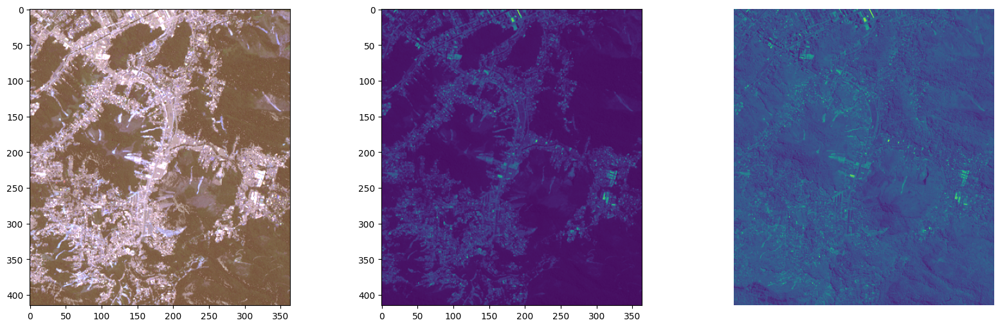

In [ ]:
# load the image
img2022, image2022_ds = load_cbers_image('/content/recortes_20220304/',
                                   ['cbers4a_wpm_20220304_198_141_l4_b0',
                                    'cbers4a_wpm_20220304_198_141_l4_b1',
                                    'cbers4a_wpm_20220304_198_141_l4_b2',
                                    'cbers4a_wpm_20220304_198_141_l4_b3',
                                    'cbers4a_wpm_20220304_198_141_l4_b4'])
# create the RGBNIR for the image - BGRNIR
rgb2022_nir = np.stack([img2022['cbers4a_wpm_20220304_198_141_l4_b1'],
                       img2022['cbers4a_wpm_20220304_198_141_l4_b2'],
                       img2022['cbers4a_wpm_20220304_198_141_l4_b3'],
                       img2022['cbers4a_wpm_20220304_198_141_l4_b4']], axis=2)
rgb2022_nir = rgb2022_nir / rgb2022_nir.max()

# load bands 1 and 0
b0_2022_ds = rasterio.open('/content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b0.tif')
b1_2022_ds = rasterio.open('/content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b1.tif')

b0_2022_array = b0_2022_ds.read(1)
b1_2022_array = b1_2022_ds.read(1)

# Plot the 3 images
fig, ax = plt.subplots(1, 3, figsize=(20, 6))
ax[0].imshow(rgb2022_nir*3)
ax[1].imshow(b1_2022_array);
ax[2].imshow(b0_2022_array);
plt.axis('off')

###4.1: Sistema de Referência de Coordenadas CRS

In [ ]:
print('Band Green B2: \n', image2022_ds['cbers4a_wpm_20220304_198_141_l4_b2'].profile)
print('Band Pan  B0: \n', b0_2022_ds.profile)
print('Band Blue B1: \n', b1_2022_ds.profile)

Band Green B2: 
 {'driver': 'GTiff', 'dtype': 'int16', 'nodata': 0.0, 'width': 364, 'height': 415, 'count': 1, 'crs': CRS.from_epsg(32723), 'transform': Affine(8.0, 0.0, 686714.0,
       0.0, -8.0, 7509822.0), 'blockysize': 11, 'tiled': False, 'interleave': 'band'}
Band Pan  B0: 
 {'driver': 'GTiff', 'dtype': 'int16', 'nodata': 0.0, 'width': 1455, 'height': 1662, 'count': 1, 'crs': CRS.from_epsg(32723), 'transform': Affine(2.0, 0.0, 686714.0,
       0.0, -2.0, 7509822.0), 'blockysize': 2, 'tiled': False, 'interleave': 'band'}
Band Blue B1: 
 {'driver': 'GTiff', 'dtype': 'int16', 'nodata': 0.0, 'width': 364, 'height': 415, 'count': 1, 'crs': CRS.from_epsg(32723), 'transform': Affine(8.0, 0.0, 686714.0,
       0.0, -8.0, 7509822.0), 'blockysize': 11, 'tiled': False, 'interleave': 'band'}


###4.2: Salvando imagens com sistema de referências
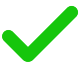

In [ ]:
from osgeo import gdal
dataset2022 = gdal.Open("/content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b2.tif", gdal.GA_ReadOnly)
type(dataset2022)

osgeo.gdal.Dataset

In [ ]:
GT2022 = dataset2022.GetGeoTransform()

print(type(rgb2022_nir))

dst_crs='EPSG:32723'
print(rgb2022_nir.shape)

<class 'numpy.ndarray'>
(415, 364, 4)


In [ ]:
saida2022 = np.float32(rgb2022_nir)

In [ ]:
print(GT2022)

(686714.0, 8.0, 0.0, 7509822.0, 0.0, -8.0)


In [ ]:
from affine import Affine
transf2022 = (686714.0, 8.0, 0.0, 7509822.0, 0.0, -8.0)
af_transf2022 = Affine.from_gdal(*transf2022)
print(af_transf2022)

| 8.00, 0.00, 686714.00|
| 0.00,-8.00, 7509822.00|
| 0.00, 0.00, 1.00|


In [ ]:
saida2022.shape

(415, 364, 4)

In [ ]:
print(saida2022.shape[0], saida2022.shape[1], saida2022.shape[2])

415 364 4


In [ ]:
with rasterio.open('image2022.tif', 'w',
                  driver='GTiff',
                  height=saida2022.shape[0],
                  width=saida2022.shape[1],
                  count=saida2022.shape[2],
                  dtype=np.float32,
                  crs=dst_crs,
                  transform=af_transf2022) as dst:
    # If saida2022 is in (y, x, z) order (rows, cols, bands)
    dst.write(np.moveaxis(saida2022, [0, 1, 2], [1, 2, 0]))

In [ ]:
img = gdal.Open('/content/image2022.tif')
r = img.GetGeoTransform()
print(r)

(686714.0, 8.0, 0.0, 7509822.0, 0.0, -8.0)


(4, 415, 364) (415, 364, 4)


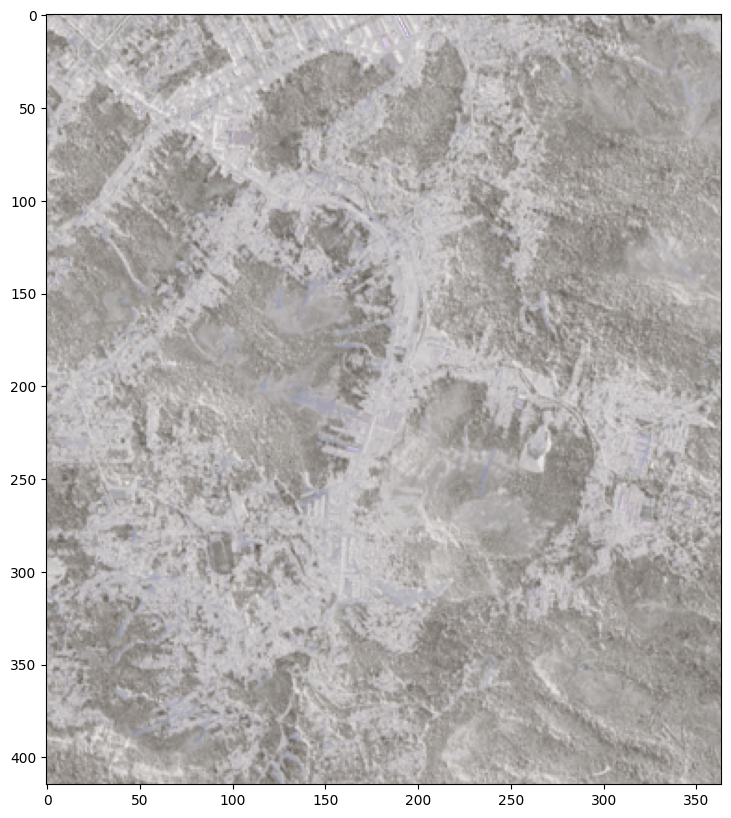

In [ ]:
img2022_array = rasterio.open('/content/image2022.tif').read()
img2022_array_ = np.transpose(img2022_array, (1, 2, 0))
print(img2022_array.shape, img2022_array_.shape)
plt.figure(figsize=(10, 10))
plt.imshow(img2022_array_);

###4.3: Criando pansharpening

In [ ]:
# pansharpening
# For GDAL >= 3.3:
# from osgeo.osgeo_utils import gdal_pansharpen
from osgeo_utils.gdal_pansharpen import gdal_pansharpen
gdal_pansharpen(
    pan_name='/content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b0.tif',
    spectral_names=['/content/image2022.tif'],
    band_nums=[1, 2, 3, 4],
    dst_filename='output2022_pansharpenedBGRNIR.tif')

0

In [ ]:
img2022_array = rasterio.open('/content/output2022_pansharpenedBGRNIR.tif').read()
# img2022_array_ = np.transpose(img2022_array, (1, 2, 0))
# print(img2022_array.shape, img2022_array_.shape)
# plt.figure(figsize=(10, 10))
# plt.imshow(img2022_array_);
print(img2022_array.shape, img_array.shape)  # 4, 1662, 1452

(4, 1662, 1455) (4, 1662, 1452)


(1662, 1455, 4)


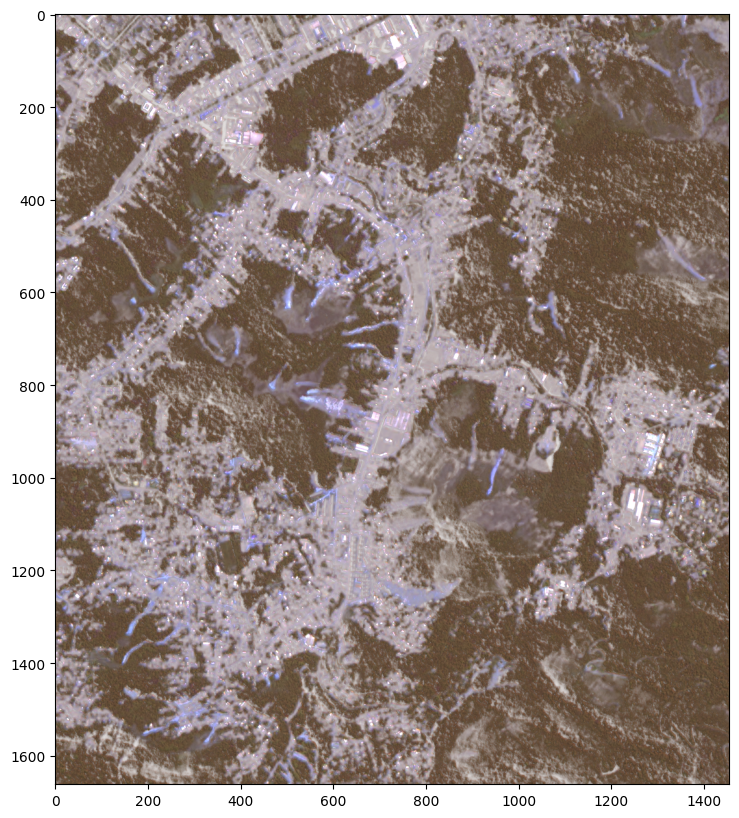

In [ ]:
pansharp2022 = rasterio.open('/content/output2022_pansharpenedBGRNIR.tif').read()
# Stack RGB NIR
pansharp2022 = np.stack([pansharp2022[0],pansharp2022[1],
                  pansharp2022[2],pansharp2022[3]], axis=2)
# pansharp2022 = np.stack(pansharp2022, axis=2)
# pansharp2022 = np.dstack(pansharp2022)

print(pansharp2022.shape)

rgb2022_pansharp = pansharp2022 / pansharp2022.max()
plt.figure(figsize=(10, 10))
plt.imshow(rgb2022_pansharp*3)

In [ ]:
dataset2022 = gdal.Open("/content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b0.tif", gdal.GA_ReadOnly)
GT2022 = dataset2022.GetGeoTransform()
print(GT2022)

(686714.0, 2.0, 0.0, 7509822.0, 0.0, -2.0)


###4.4: Mostrando Imagens 2022: RGB, RGNIR and Pansharpening

Opening file /content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b1.tif
Opening file /content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b2.tif
Opening file /content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b3.tif
Opening file /content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b1.tif
Opening file /content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b2.tif
Opening file /content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b3.tif
Opening file /content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b4.tif


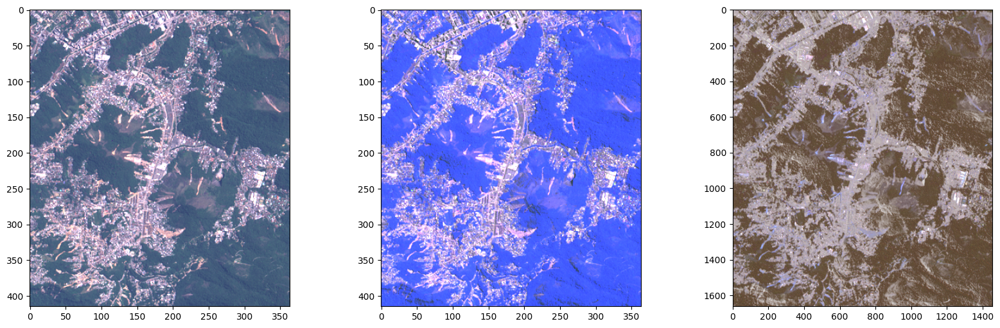

In [ ]:
# load the image
img2022, image2022_ds = load_cbers_image('/content/recortes_20220304/',
                                   ['cbers4a_wpm_20220304_198_141_l4_b1',
                                    'cbers4a_wpm_20220304_198_141_l4_b2',
                                    'cbers4a_wpm_20220304_198_141_l4_b3'])
# create the RGB for the image
rgb2022 = np.stack([img2022['cbers4a_wpm_20220304_198_141_l4_b3'],
                img2022['cbers4a_wpm_20220304_198_141_l4_b2'],
                img2022['cbers4a_wpm_20220304_198_141_l4_b1']], axis=2)
rgb2022 = rgb2022 / rgb2022.max()

# load the image
img2022_bgrnir, image2022_ds = load_cbers_image('/content/recortes_20220304/',
                                   ['cbers4a_wpm_20220304_198_141_l4_b1',
                                    'cbers4a_wpm_20220304_198_141_l4_b2',
                                    'cbers4a_wpm_20220304_198_141_l4_b3',
                                    'cbers4a_wpm_20220304_198_141_l4_b4'])
# create the RGB NIR for the image
rg_nir2022 = np.stack([img2022_bgrnir['cbers4a_wpm_20220304_198_141_l4_b3'],
                    img2022_bgrnir['cbers4a_wpm_20220304_198_141_l4_b2'],
                    img2022_bgrnir['cbers4a_wpm_20220304_198_141_l4_b4']], axis=2)
rg_nir2022 = rg_nir2022 / rg_nir2022.max()

# load image
pansharp2022 = rasterio.open('/content/output2022_pansharpenedBGRNIR.tif').read()
pansharp2022 = np.dstack(pansharp2022)
pansharp2022 = pansharp2022 / pansharp2022.max()
# Plot the 3 images
fig, ax = plt.subplots(1, 3, figsize=(20, 6));
ax[0].imshow(rgb2022*3)
ax[1].imshow(rg_nir2022*3)
ax[2].imshow(pansharp2022*3);

In [ ]:
print(rgb2022.shape, rg_nir2022.shape, pansharp2022.shape)  #(415, 363, 3) (415, 363, 4) (1662, 1452)<--

(415, 364, 3) (415, 364, 3) (1662, 1455, 4)


## 5: Corte de imagem pansharpening 2022 igual a 2021 para fazer concatenação

In [ ]:
import random
import rasterio
from rasterio.windows import Window

with rasterio.open('/content/output2022_pansharpenedBGRNIR.tif') as src:

    # The size in pixels of your desired window
    xsize, ysize = 1452, 1662

    # Generate a random window origin (upper left) that ensures the window
    # doesn't go outside the image. i.e. origin can only be between
    # 0 and image width or height less the window width or height
    xmin, xmax = 0, src.width - xsize
    ymin, ymax = 0, src.height - ysize
    xoff, yoff = random.randint(xmin, xmax), random.randint(ymin, ymax)
    print(xoff, yoff)
    # Create a Window and calculate the transform from the source dataset
    window = Window(xoff, yoff, xsize, ysize)
    transform = src.window_transform(window)

    # Create a new cropped raster to write to
    profile = src.profile
    profile.update({
        'height': ysize,  #<--
        'width': xsize,   #<--
        'transform': af_transf2021_2022})

    with rasterio.open('output2022_pansharpenedBGRNIR_crop.tif', 'w', **profile) as dst:
        # Read the data from the window and write it to the output raster
        dst.write(src.read(window=window))


0 0


In [ ]:
img2022_crop_array = rasterio.open('/content/output2022_pansharpenedBGRNIR_crop.tif').read()

# img2022_crop_array = np.resize(img2022_crop_array, (4, 1662,1452))
print(img2022_crop_array.shape, img_array.shape)


(4, 1662, 1452) (4, 1662, 1452)


In [ ]:
dataset2022crop = gdal.Open("/content/output2022_pansharpenedBGRNIR_crop.tif", gdal.GA_ReadOnly)
GT2022crop = dataset2022crop.GetGeoTransform()
print(GT2022crop)  #(686716.0, 2.0, 0.0, 7509824.0, 0.0, -2.0) <- OK

(686716.0, 2.0, 0.0, 7509824.0, 0.0, -2.0)


In [ ]:
# load image
pansharp2022crop = rasterio.open('/content/output2022_pansharpenedBGRNIR_crop.tif').read()
# Stack
pansharp2022crop_ = np.stack([pansharp2022crop[2],pansharp2022crop[1],
                              pansharp2022crop[0],pansharp2022crop[3]], axis=2)
pansharp2022crop_ = pansharp2022crop_ / pansharp2022crop_.max()

print(pansharp2022crop_.shape)

img = pansharp2022crop_ / pansharp2022crop_.max()

(1662, 1452, 4)


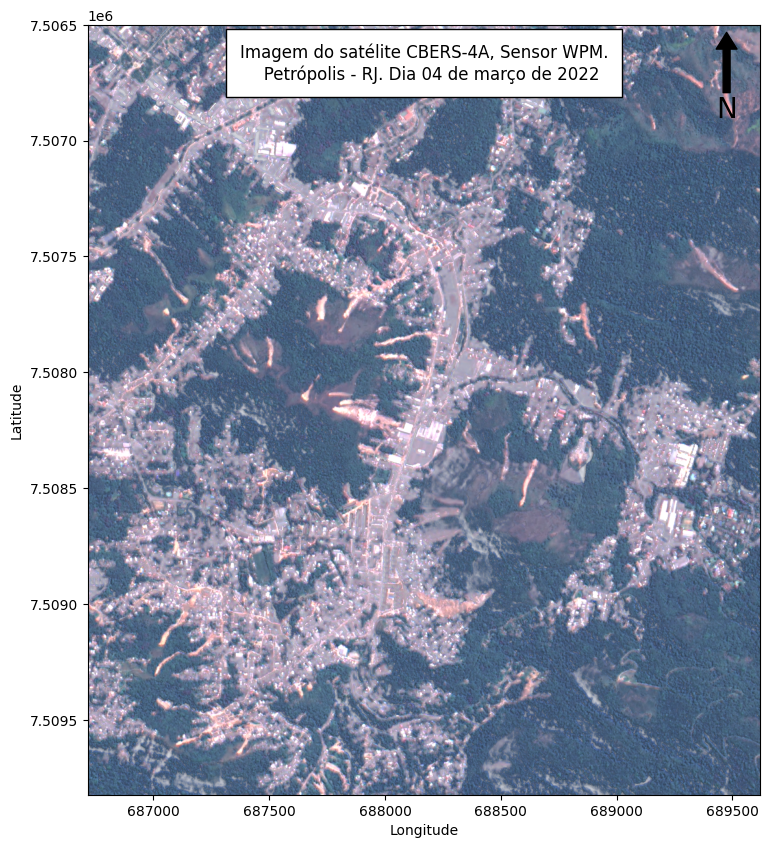

Projeção: EPSG:32723
Transformação: | 2.00, 0.00, 686716.00|
| 0.00,-2.00, 7509824.00|
| 0.00, 0.00, 1.00|


In [ ]:
# Carregue a imagem raster com rasterio
path_to_raster = "/content/output2022_pansharpenedBGRNIR_crop.tif"
dataset = rasterio.open(path_to_raster)

# Ler os dados e a transformação do raster
data = dataset.read(1)  # Assumindo que é uma banda de dados
transform = dataset.transform

# Obter coordenadas de latitude e longitude para as bordas do raster
min_x, min_y = transform * (0, 0)
max_x, max_y = transform * (data.shape[1], data.shape[0])

# Plotar a imagem raster usando matplotlib
fig, ax = plt.subplots(1, figsize=(15, 10))

# Plotar o raster com imshow e integração com o plt
img = ax.imshow(img * 4, cmap="terrain", extent=[min_x, max_x, min_y, max_y])
# plt.colorbar(img, label="Escala")

# Personalizar rótulos e título do gráfico
plt.xlabel("Longitude")
plt.ylabel("Latitude")
# plt.title("Desastre em São Sebastião - SP")

# Inserir grids
# ax.grid(color='0.95', linestyle='dashed', linewidth=0.5, alpha=0.5)

# # Plotar box de informações

# Adicionar informações sobre a imagem
ax.text(0.5, 0.95,'Imagem do satélite CBERS-4A, Sensor WPM.\n   Petrópolis - RJ. Dia 04 de março de 2022',
        fontsize=12, transform=ax.transAxes, ha='center', va='center', bbox={'facecolor': 'white', 'pad': 10})

# Adicionar a orientação do norte
x, y, arrow_length = 0.95, 0.99, 0.1
ax.annotate('N', xy=(x, y), xytext=(x, y - arrow_length),
            arrowprops=dict(facecolor='black', width=5, headwidth=15),
            ha='center', va='center', fontsize=20,
            xycoords=ax.transAxes)

# Mostrar o gráfico na tela
plt.show()

# Abrir o arquivo raster
with rasterio.open(path_to_raster) as dataset:
    # Obter informações sobre a projeção e o sistema de referência geográfica
    crs = dataset.crs
    transform = dataset.transform

# Imprimir informações
print("Projeção:", crs)
print("Transformação:", transform)

##6: Concatenação de imagens pansharpening 2022 e 2021 (T2/T1)

(8, 1662, 1452)
(1662, 1452, 4)


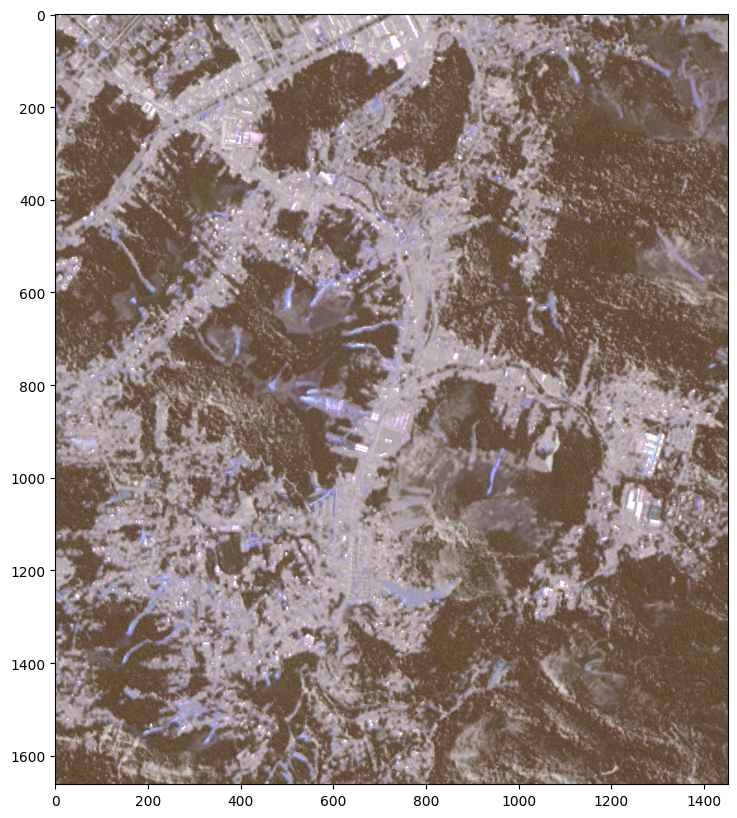

In [ ]:
array_T1 = rasterio.open('/content/output_pansharpened2021BGRNIR.tif').read()
array_T2 = rasterio.open('/content/output2022_pansharpenedBGRNIR_crop.tif').read()

merge = np.concatenate((array_T2,array_T1), axis=0)  # axis 0 profundidade, 1 hor, 2 vert
print(merge.shape)

# plt.figure(figsize=(15,10))
# plt.gray()
# plt.imshow(merge[0,:,:]);

# Stack RGB NIR
merge_ = np.stack([merge[0],merge[1],
                  merge[2],merge[3]], axis=2)
# merge_ = np.stack(merge, axis=2)
# merge_ = np.dstack(merge)

print(merge_.shape)

rgb_t2_t1 = merge_ / merge_.max()
plt.figure(figsize=(15, 10))
plt.imshow(rgb_t2_t1*3)

In [ ]:
#save image concatenated T2 and T1, to create patches
merge_.shape

(1662, 1452, 4)

In [ ]:
# SAVE
with rasterio.open(
    'raster_out_concatenate_t2_t1.tif',
    'w',
    driver='GTiff',
    height=merge.shape[1],
    width=merge.shape[2],
    count=8,
    dtype=np.float32,
    crs=dst_crs,
    transform=af_transf2021_2022,
) as dest_file:
    dest_file.write(merge)
dest_file.close()

(1662, 1452, 4)


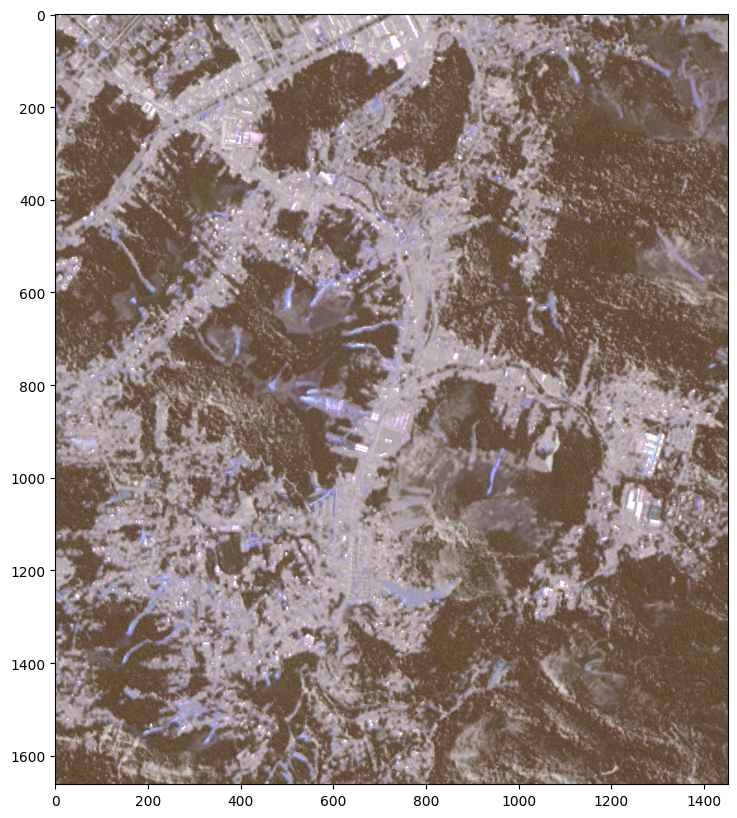

In [ ]:
img_concat_array = rasterio.open('raster_out_concatenate_t2_t1.tif').read()
# plt.figure(figsize=(10, 10))
# plt.imshow(img_concat_array[0,:,:]);
# Stack RGB NIR - 8 channels
img_concat_array = np.stack([img_concat_array[0],img_concat_array[1],
                  img_concat_array[2],img_concat_array[3]], axis=2)
# img_concat_array = np.stack(img_concat_array, axis=2)
# img_concat_array = np.dstack(img_concat_array)

print(img_concat_array.shape)

concat_t2_t1 = img_concat_array / img_concat_array.max()
plt.figure(figsize=(15, 10))
plt.imshow(concat_t2_t1*3)

In [ ]:
dataset_concatenate = gdal.Open("raster_out_concatenate_t2_t1.tif", gdal.GA_ReadOnly)
GT_concatenate = dataset_concatenate.GetGeoTransform()
print(GT_concatenate)

(686716.0, 2.0, 0.0, 7509824.0, 0.0, -2.0)


## 7: Após a rotulação de deslizamentos de terra no QGIS, criar patches de rótulos 64 x 64

In [ ]:
# !pip install --upgrade --no-cache-dir gdown
# !gdown 1kUlQxvQM2mYeSLBV73xaCmuD-VzIaltU

In [ ]:
!mv /content/recortes_imagem_petropolis/recortes_imagem/CBERS_4A_WPM_20220304_198_141_L4_p_cut_class.tif /content/

(1, 1663, 1453)

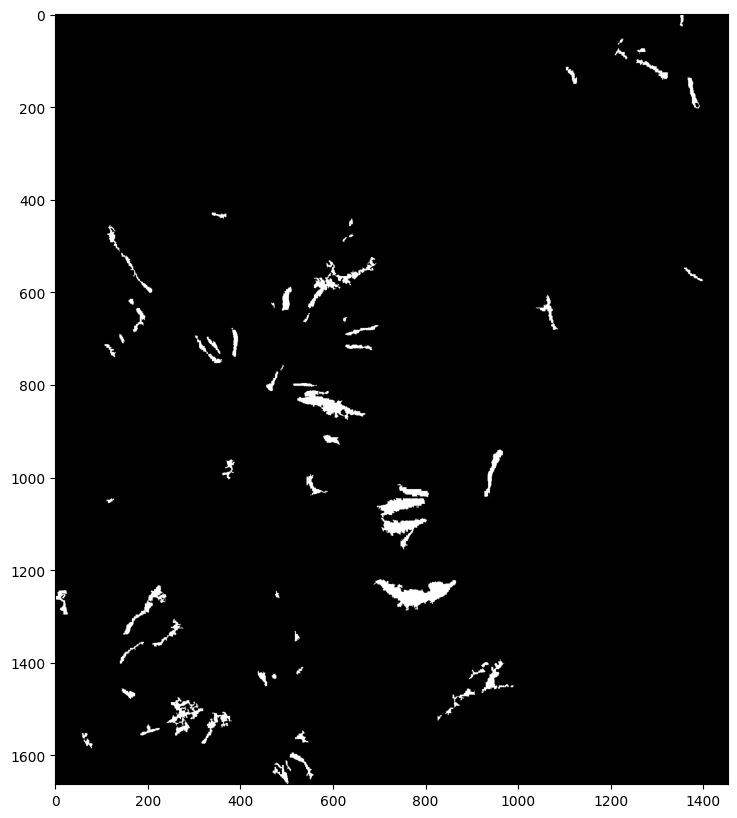

In [ ]:
img_labels = rasterio.open('/content/CBERS_4A_WPM_20220304_198_141_L4_p_cut_class.tif').read()
plt.figure(figsize=(10, 10))
plt.imshow(img_labels[0,:,:], cmap='gray');
img_labels.shape

In [ ]:
import random
import rasterio
from rasterio.windows import Window

with rasterio.open('/content/CBERS_4A_WPM_20220304_198_141_L4_p_cut_class.tif') as src:

    # The size in pixels of your desired window
    xsize, ysize = 1452, 1662

    # Generate a random window origin (upper left) that ensures the window
    # doesn't go outside the image. i.e. origin can only be between
    # 0 and image width or height less the window width or height
    xmin, xmax = 0, src.width - xsize
    ymin, ymax = 0, src.height - ysize
    xoff, yoff = random.randint(xmin, xmax), random.randint(ymin, ymax)
    print(xoff, yoff)
    # Create a Window and calculate the transform from the source dataset
    window = Window(xoff, yoff, xsize, ysize)
    transform = src.window_transform(window)

    # Create a new cropped raster to write to
    profile = src.profile
    profile.update({
        'height': ysize,  #<--
        'width': xsize,   #<--
        "count": 1,
        "dtype": np.float64,
        "crs": dst_crs,
        "transform": af_transf2021_2022
        })

    with rasterio.open('CBERS_4A_WPM_20220304_198_141_L4_p_cut_class_crop.tif', 'w', **profile) as dst:
        # Read the data from the window and write it to the output raster
        dst.write(src.read(window=window))


0 0


In [ ]:
dataset_labels = gdal.Open("CBERS_4A_WPM_20220304_198_141_L4_p_cut_class_crop.tif", gdal.GA_ReadOnly)
GT_labels = dataset_labels.GetGeoTransform()
print(GT_labels)   #(686716.0, 2.0, 0.0, 7509824.0, 0.0, -2.0) <-  ok

(686716.0, 2.0, 0.0, 7509824.0, 0.0, -2.0)


(1, 1662, 1452)

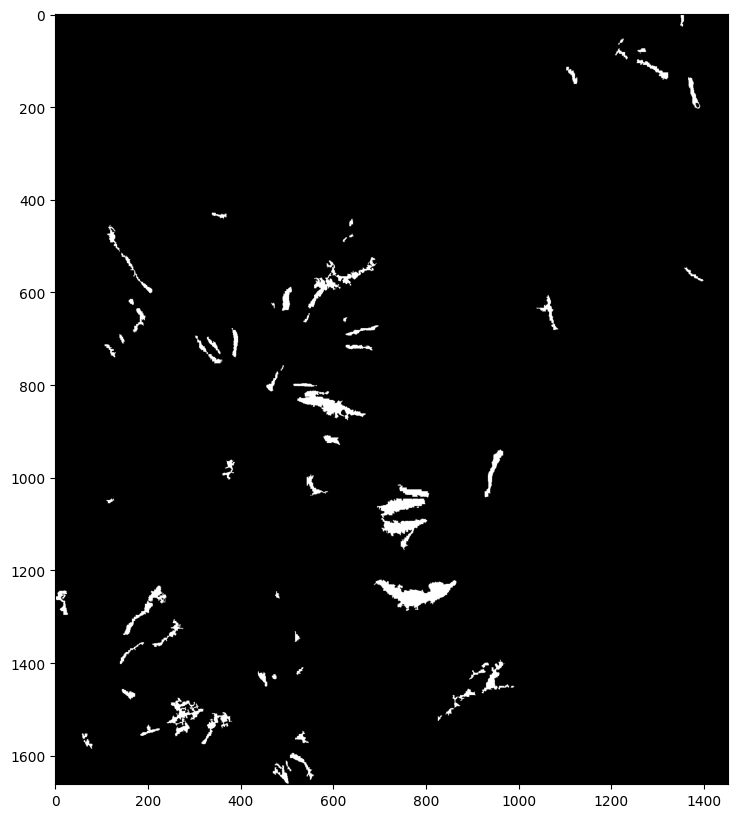

In [ ]:
img_labels = rasterio.open('CBERS_4A_WPM_20220304_198_141_L4_p_cut_class_crop.tif').read()
plt.figure(figsize=(10, 10))
plt.imshow(img_labels[0,:,:], cmap='gray');
img_labels.shape

## 8: Merged patches classes e cenas


### 8.1: classes

Digite o tamanho desejado para os patches: 64
A imagem não é divisível uniformemente pelo tamanho do patch (64). Deseja cortar a imagem para torná-la divisível? (S/N): s
(1600, 1408)


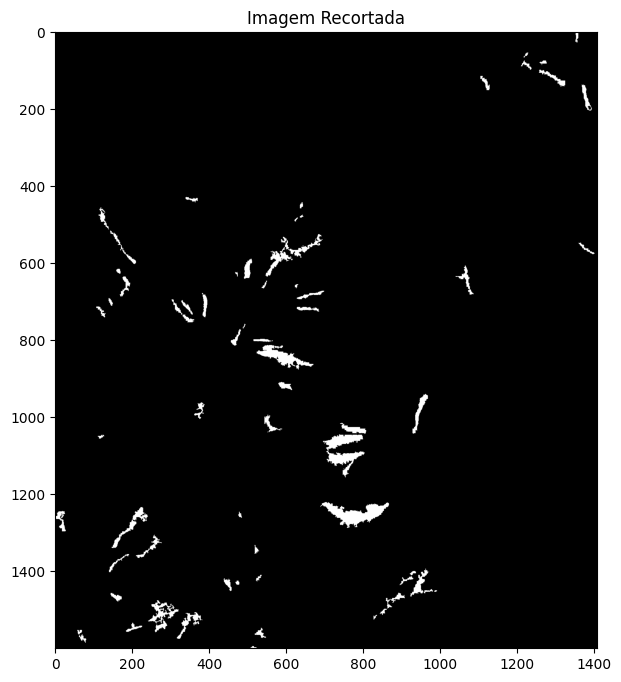

Foram criados 550 patches.


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import rasterio

def generate_patches(image_path, patch_size, fill_with_zeros=False):
    with rasterio.open(image_path) as src:
        image = src.read(1)  # Assuming it's a single-band image
        height, width = image.shape

        # Verificar se o tamanho da imagem é divisível pelo tamanho do patch
        if height % patch_size != 0 or width % patch_size != 0:
            answer = input(f"A imagem não é divisível uniformemente pelo tamanho do patch ({patch_size}). Deseja cortar a imagem para torná-la divisível? (S/N): ").upper()

            if answer == 'N':
                print("Operação cancelada. Não foram gerados patches.")
                return None

            if answer == 'S':
                # Ajustar o tamanho da imagem para ser divisível pelo tamanho do patch
                new_height = height - (height % patch_size)
                new_width = width - (width % patch_size)
                image = image[:new_height, :new_width]

                # Atualizar as dimensões
                height, width = new_height, new_width

    patches = []
    for y in range(0, height, patch_size):
        for x in range(0, width, patch_size):
            patch = image[y:min(y+patch_size, height), x:min(x+patch_size, width)]

            if fill_with_zeros and patch.shape != (patch_size, patch_size):
                zero_padded_patch = np.zeros((patch_size, patch_size), dtype=patch.dtype)
                zero_padded_patch[:patch.shape[0], :patch.shape[1]] = patch
                patch = zero_padded_patch
            elif patch.shape == (patch_size, patch_size):
                patches.append(patch)

    h,w = image.shape  # altura e largura da imagem recortada
    print(image.shape )
    # Exibir a imagem recortada
    plt.figure(figsize=(8, 8))
    plt.imshow(image, cmap='gray')
    plt.title('Imagem Recortada')
    plt.show()

    return np.array(patches), h, w

# Parâmetros
image_path = '/content/CBERS_4A_WPM_20220304_198_141_L4_p_cut_class_crop.tif'
fill_with_zeros = True

# Perguntar ao usuário o tamanho desejado para os patches
patch_size = int(input("Digite o tamanho desejado para os patches: "))

# Gerar patches
patches_classes, h, w = generate_patches(image_path, patch_size, fill_with_zeros)

# Se não houver patches (usuário optou por não cortar a imagem), encerrar o programa
if patches_classes is None or len(patches_classes) == 0:
    exit()
else:
  # Exibir a quantidade de patches criados
  num_patches = len(patches_classes)
  print(f'Foram criados {num_patches} patches.')


In [ ]:
1600/64, 1408/64, len(patches_classes)

(25.0, 22.0, 550)

(1, 1662, 1452)

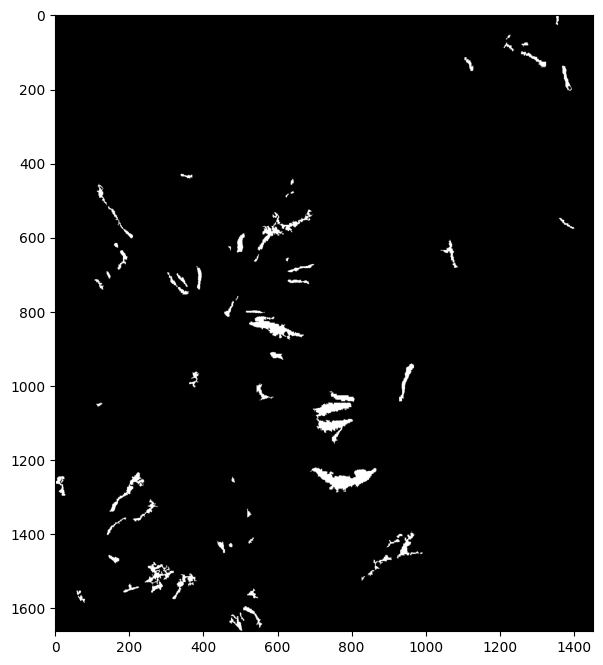

In [ ]:
import rasterio
import matplotlib.pyplot as plt

img_labels = rasterio.open('CBERS_4A_WPM_20220304_198_141_L4_p_cut_class_crop.tif').read()
plt.figure(figsize=(8, 8))
plt.imshow(img_labels[0,:,:], cmap='gray');
img_labels.shape

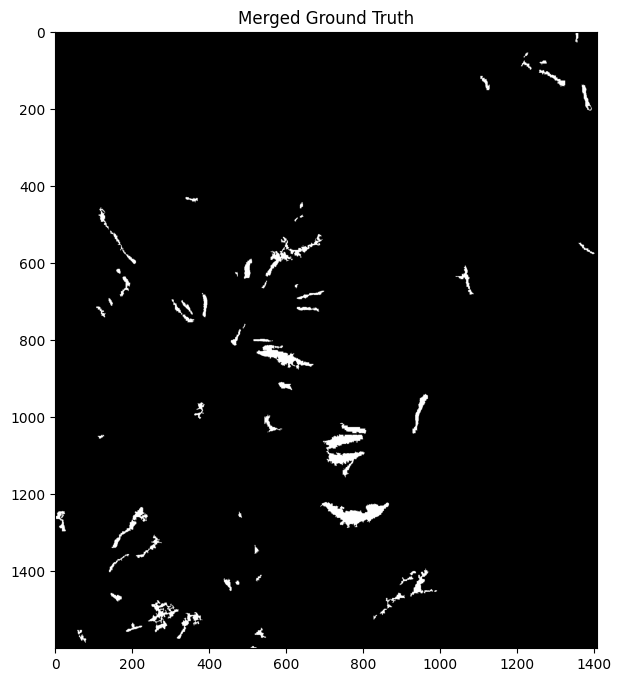

(1600, 1408)

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from keras.preprocessing import image
import PIL.ImageOps


# Cria imagens vazias para armazenar os patches da classe verdadeira e dos patches preditos
merged_true_image = np.zeros((h, w))  # Assume que a forma é a mesma que a imagem original
# merged_pred_image = np.zeros((h, w))

# Tamanho dos patches
patch_size = patches_classes.shape[2]

# Vizualização dos patches_classes
for index in range(len(patches_classes)):
    # ...

    # Calcula as coordenadas corretas para colocar o patch na imagem combinada
    row_start = index // (w // patch_size) * patch_size
    col_start = (index % (w // patch_size)) * patch_size

    # Preenche as imagens combinadas com os patches correspondentes
    merged_true_image[row_start:row_start+patch_size, col_start:col_start+patch_size] += patches_classes[index]
    # merged_pred_image[row_start:row_start+patch_size, col_start:col_start+patch_size] += y_pred_argmax[index]

    # ...

# Imagem da classe verdadeira

plt.figure(figsize=(8, 8))
plt.imshow(merged_true_image, cmap='gray')
plt.title('Merged Ground Truth')

plt.show()

# # Imagem dos patches preditos
# plt.subplot(122)
# merged_image = np.clip(merged_image, 0, 1)  # Para garantir que os valores estejam no intervalo [0, 1]
# plt.imshow(merged_pred_image, cmap='gray')
# plt.title('Merged Predictions')


merged_true_image.shape

### 8.2: cenas

Digite o tamanho desejado para os patches: 64
A imagem não é divisível uniformemente pelo tamanho do patch (64). Deseja cortar a imagem para torná-la divisível? (S/N): s
(8, 1600, 1408)
(1600, 1408, 3)


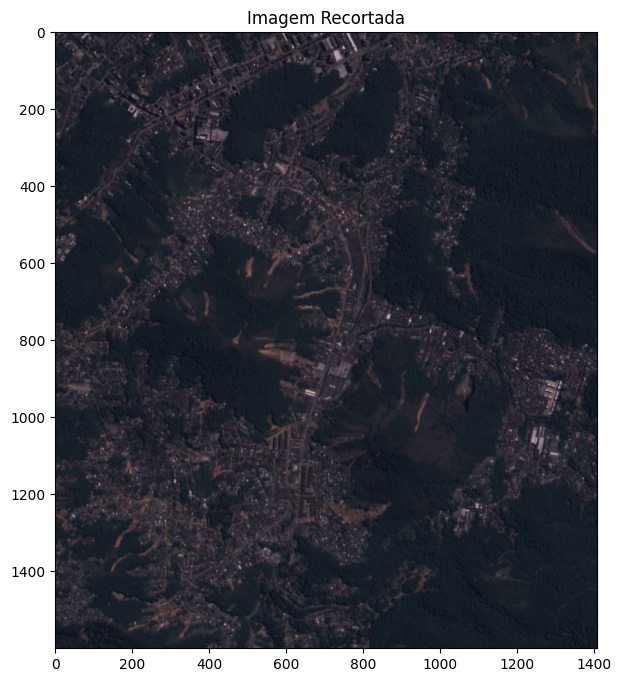

Foram criados 550 patches scenes.


In [ ]:
import rasterio
import numpy as np
import matplotlib.pyplot as plt

def generate_multispectral_patches(image_path, patch_size, fill_with_zeros=False):
    with rasterio.open(image_path) as src:
        image = src.read()  # Lê todas as bandas da imagem
        num_bands, height, width = image.shape

        # Verificar se o tamanho da imagem é divisível pelo tamanho do patch
        if height % patch_size != 0 or width % patch_size != 0:
            answer = input(f"A imagem não é divisível uniformemente pelo tamanho do patch ({patch_size}). Deseja cortar a imagem para torná-la divisível? (S/N): ").upper()

            if answer == 'N':
                print("Operação cancelada. Não foram gerados patches.")
                return None

            if answer == 'S':
                # Ajustar o tamanho da imagem para ser divisível pelo tamanho do patch
                new_height = height - (height % patch_size)
                new_width = width - (width % patch_size)
                image = image[:, :new_height, :new_width]

                # Atualizar as dimensões
                num_bands, height, width = image.shape

    patches = []
    for y in range(0, height, patch_size):
        for x in range(0, width, patch_size):
            patch = image[:, y:min(y+patch_size, height), x:min(x+patch_size, width)]

            if fill_with_zeros and patch.shape != (num_bands, patch_size, patch_size):
                zero_padded_patch = np.zeros((num_bands, patch_size, patch_size), dtype=patch.dtype)
                zero_padded_patch[:, :patch.shape[1], :patch.shape[2]] = patch
                patch = zero_padded_patch
            elif patch.shape == (num_bands, patch_size, patch_size):
                patches.append(patch)

    h, w = image.shape[1], image.shape[2]  # altura e largura da imagem recortada
    print(image.shape)

    selected_bands = [2, 1, 0]  # BGR para RGB

    # Ajuste a forma da imagem para ser exibida como RGB
    rgb_image = np.transpose(image[selected_bands, :, :], (1, 2, 0))  # Seleciona os três primeiros canais e transpõe as dimensões para RGB

    # Normalizar a imagem para exibição entre 0 e 1
    rgb_image = rgb_image / np.max(rgb_image)
    print(rgb_image.shape)
    # Exibir a imagem recortada
    plt.figure(figsize=(8, 8))
    plt.imshow(rgb_image)
    plt.title('Imagem Recortada')
    plt.show()

    return np.array(patches), h, w

# Parâmetros
image_path = '/content/raster_out_concatenate_t2_t1.tif'
fill_with_zeros = True

# Perguntar ao usuário o tamanho desejado para os patches
patch_size = int(input("Digite o tamanho desejado para os patches: "))

# Gerar patches
patches_scenes, h, w = generate_multispectral_patches(image_path, patch_size, fill_with_zeros)

# Se não houver patches (usuário optou por não cortar a imagem), encerrar o programa
if patches_scenes is None or len(patches_scenes) == 0:
    exit()
else:
  # Exibir a quantidade de patches_scenes criados
  num_patches_scenes = len(patches_scenes)
  print(f'Foram criados {num_patches_scenes} patches scenes.')


In [ ]:
patches_scenes.shape

(550, 8, 64, 64)

(1600, 1408, 8)
(1600, 1408, 3)


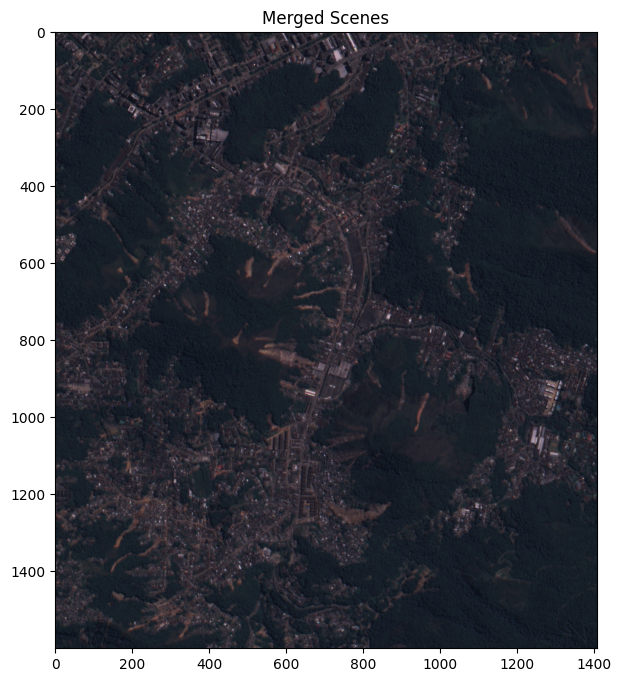

In [ ]:
# Tamanho dos patches
patch_size = patches_scenes.shape[2]

# Cria imagem vazia para armazenar os patches das cenas
merged_scenes_image = np.zeros((h, w, patches_scenes.shape[1]))  # Assumindo que a forma é a mesma que a imagem original

# Vizualização dos patches
for index in range(len(patches_scenes)):
    # Calcula as coordenadas corretas para colocar o patch na imagem combinada
    row_start = index // (w // patch_size) * patch_size
    col_start = (index % (w // patch_size)) * patch_size

    # Adiciona a contribuição do patche à imagem combinada
    merged_scenes_image[row_start:row_start+patch_size, col_start:col_start+patch_size, :] += np.transpose(patches_scenes[index], (1, 2, 0))

# Normaliza a imagem combinada
merged_scenes_image /= len(patches_scenes)
print(merged_scenes_image.shape)

# Imagem da classe verdadeira
plt.figure(figsize=(8, 8))
selected_bands = [2, 1, 0]  # BGR para RGB

# Ajusta a forma da imagem para ser exibida como RGB
rgb_merged_scenes_image = merged_scenes_image[:, :, selected_bands]

# Normaliza a imagem para exibição entre 0 e 1
rgb_merged_scenes_image = rgb_merged_scenes_image / np.max(rgb_merged_scenes_image)
print(rgb_merged_scenes_image.shape)
plt.imshow(rgb_merged_scenes_image)
plt.title('Merged Scenes')
plt.show()

## 9: Tensorflow Keras

## Introdução

### Modelo de Segmentação Semântica CNN utilizando Keras, para classificação pixel a pixel de patches de imagens bitempotais de deslizamentos de terra do desastre ocorrido em 15 de Fevereiro de 2022 na região de Petrópolis, Rio de Janeiro. A ideia desse projeto foi utilizar a  arquitetura de Segmentação Semântica U-net, usada no Hackathon WorCAP 2022 para classes do Cerrado, organizado pelo Instituto Nacional de Pesquisa Espacial (INPE) [2], aplicando a resolução para o domínio Deslizamento de Terra.
<hr style="border:1px solid #7D26CD">

In [ ]:
import os
import glob
# Dados
import imgaug as ia
import imgaug.augmenters as iaa
import random
import PIL
from PIL import Image
from PIL import ImageOps

# Leitura das imagens
from skimage import io

import numpy as np
import time

import pandas as pd
from tensorflow.keras.preprocessing import image

# Machine Learning
import tensorflow as tf
from tensorflow import keras
from sklearn.metrics import f1_score, classification_report, accuracy_score, confusion_matrix

# Gráficos
import matplotlib.pyplot as plt
import random
from imageio import mimread

tf.__version__

'2.15.0'

In [ ]:
seed = 42
np.random.seed = seed
random.seed = seed
tf.random.set_seed(42)

## 10: Teste de generalização de U-Net para Petrópolis

In [ ]:
patches_scenes.shape, patches_classes.shape

((550, 8, 64, 64), (550, 64, 64))

In [ ]:
# patche_ = patche_cena[:,:,:,0]
# patche_.shape

In [ ]:
# # Embaralha dados - patch, label (x,y)
# from sklearn.utils import shuffle
# def embaralha(x, y, seed=42):
#   x, y = shuffle(x, y, random_state=seed)
#   return x, y

# patch, label = embaralha(patch, label)

### 10.1: Visualizar patches das cenas e classes

In [ ]:
# variáveis para contar deslizamentos e não deslizamentos
landslide = 0
no_landslide = 0
# Listas de deslizamentos e não-deslizamentos dataset original
list_patches_ls_o = []
list_patches_n_ls_o = []
# laço de contagem
for i in range(len(patches_classes)):  #Refazer amostragem de patche_classes no QGIS?

  # print(patche_classe[i])
  # Verifica valor diferente de -1 na matriz para deslizamento
  if np.any(patches_classes[i] >= 1):
    landslide += 1
    list_patches_ls_o.append(i)
  else:
    no_landslide += 1
    list_patches_n_ls_o.append(i)
#quantidade de deslizamentos e não deslizamentos
print(f'Números de deslizamentos: {landslide}; Número de não-deslizamentos: {no_landslide}.')
print(f'Listas: \nDeslizamentos: {list_patches_ls_o};\nNão-deslizamentos: {list_patches_n_ls_o}.')

Números de deslizamentos: 112; Número de não-deslizamentos: 438.
Listas: 
Deslizamentos: [19, 21, 39, 40, 41, 42, 61, 64, 65, 87, 137, 141, 142, 155, 156, 163, 164, 178, 184, 185, 186, 197, 200, 201, 205, 206, 207, 214, 219, 222, 223, 224, 225, 226, 227, 228, 229, 230, 236, 243, 244, 246, 247, 248, 249, 251, 252, 271, 272, 273, 294, 295, 296, 317, 322, 323, 335, 336, 338, 341, 344, 353, 360, 361, 362, 363, 364, 366, 384, 385, 386, 407, 418, 421, 425, 428, 429, 430, 431, 440, 442, 443, 444, 448, 451, 452, 464, 465, 470, 476, 477, 486, 490, 491, 492, 497, 498, 499, 508, 509, 510, 511, 518, 519, 528, 529, 530, 531, 532, 533, 535, 536];
Não-deslizamentos: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 62, 63, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 88, 89, 90, 91, 92, 93, 94, 95, 96, 9

In [ ]:
patches_scenes.shape

(550, 8, 64, 64)

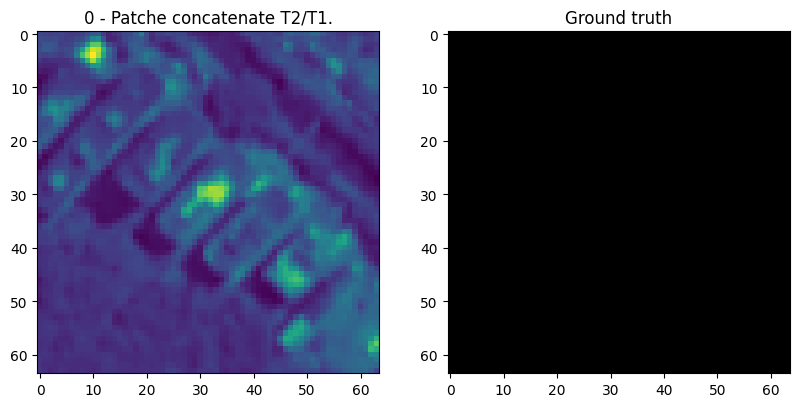

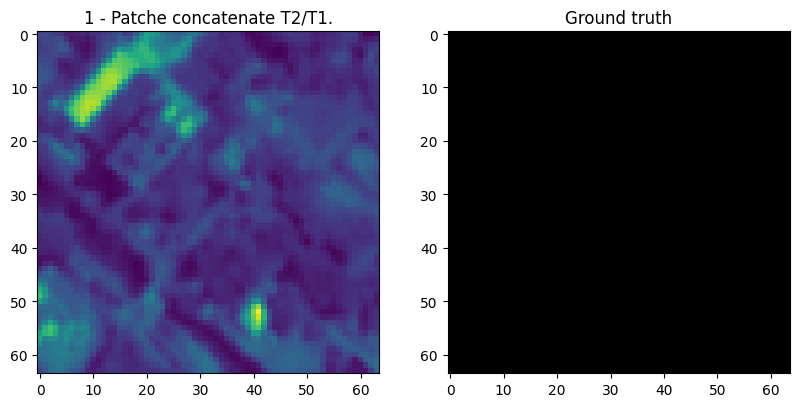

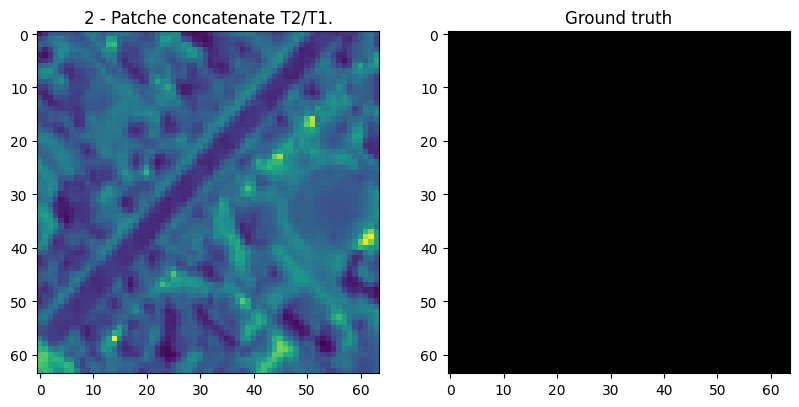

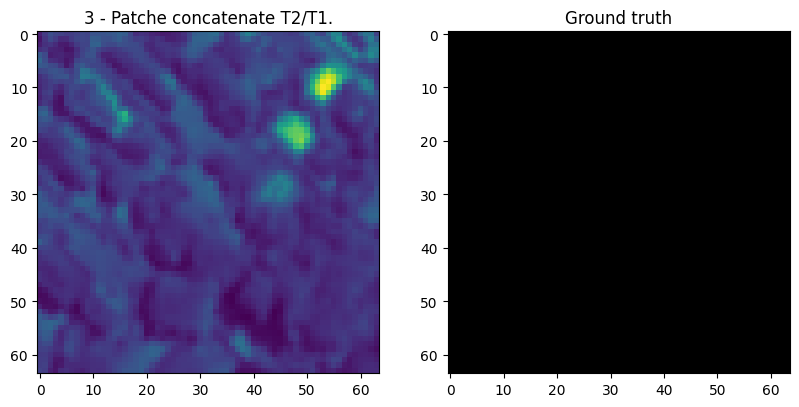

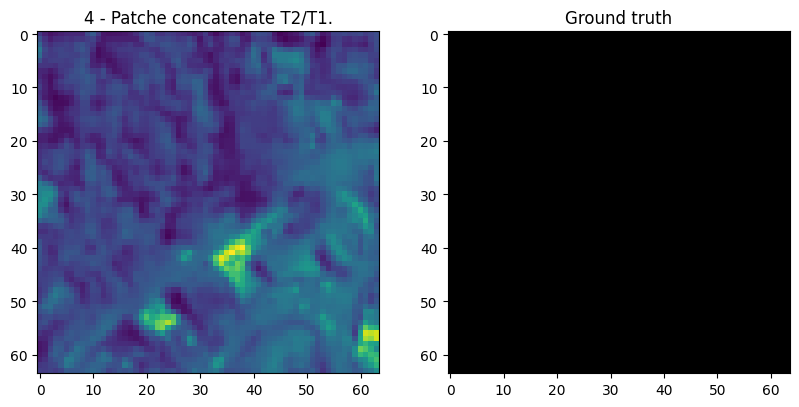

...

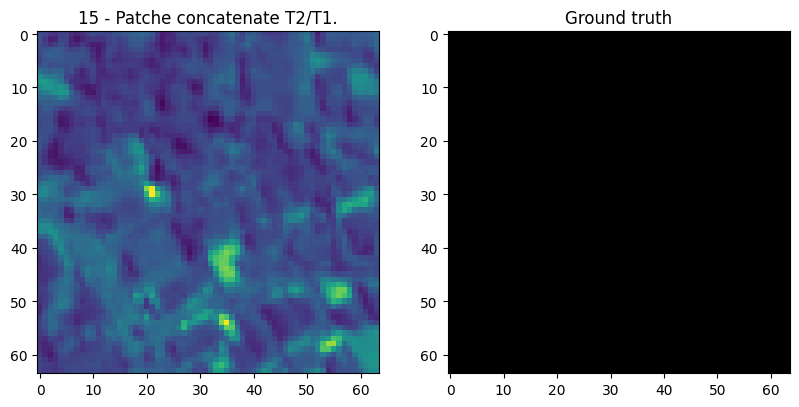

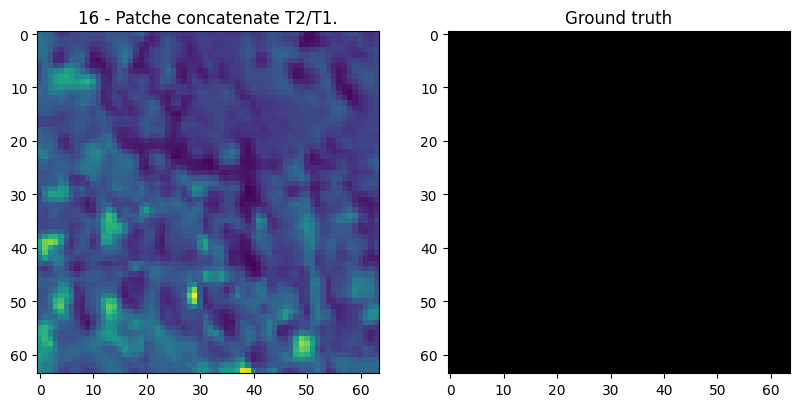

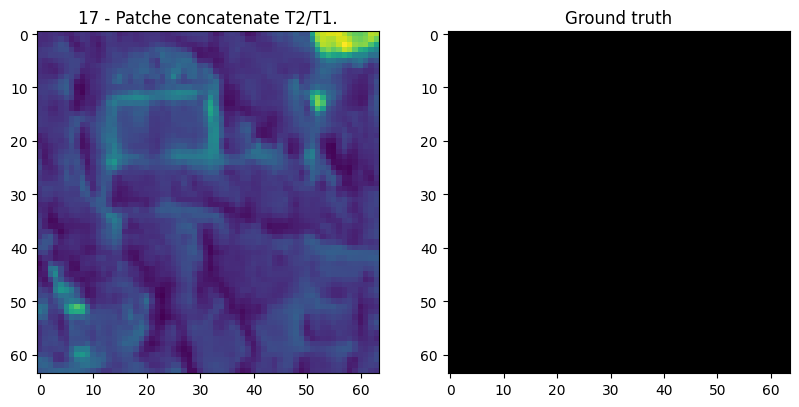

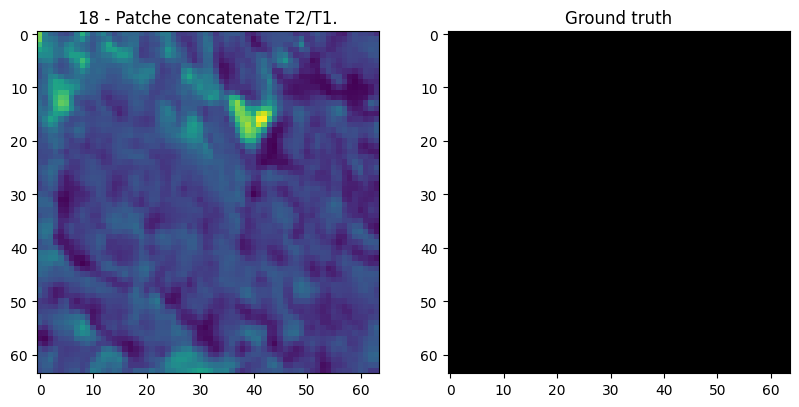

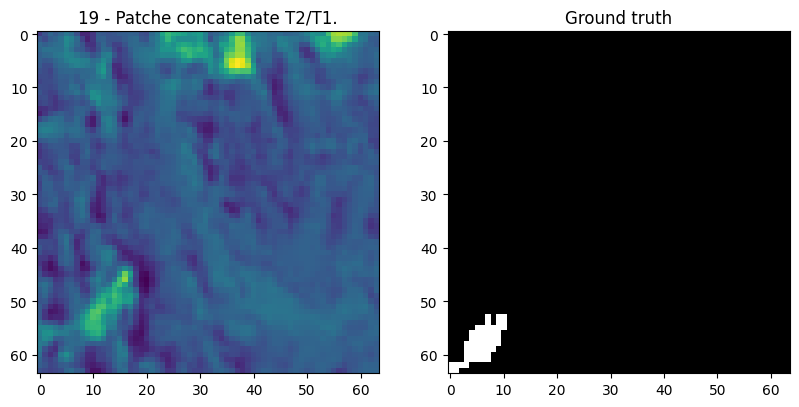

In [ ]:
for index in range(20): #len(patche_)
  # Faz Stack do label na intenção de aumentar a quantidade canais de 1 para 3
  # yt = np.dstack((label[index],label[index],label[index]))

  # Visualiza: Raster do subconjunto de treinamento
  plt.figure(figsize=(15, 10))
  plt.subplot(131)
  plt.imshow(patches_scenes[index,0,:,:])
  plt.title(f'{index} - Patche concatenate T2/T1.')

  # Visualiza: Label
  plt.subplot(132)
  plt.imshow(patches_classes[index], cmap='gray')
  # plt.title('Figura 3 - Label.')
  # m1 = image.array_to_img(yt)
  # m1 = PIL.ImageOps.autocontrast(m1)
  # plt.imshow(m1)
  plt.title('Ground truth')
  plt.show()

# yt.shap

### 10.2: Download modelo U-Net

In [ ]:
import requests

# URL direta para download do arquivo .h5
url = "https://github.com/CesarAugusto88/databases_dissertation/raw/main/model/modelo_ssebastiao_aug_treina_8e.h5"

# Nome do arquivo local
nome_arquivo = "modelo_ssebastiao_aug_treina_8e.h5"

# Baixar o conteúdo do arquivo .h5
response = requests.get(url)

# Verificar se a solicitação foi bem-sucedida
if response.status_code == 200:
    # Salvar o conteúdo no arquivo local
    with open(nome_arquivo, 'wb') as arquivo:
        arquivo.write(response.content)
else:
    print(f"Erro ao baixar o arquivo. Código de status: {response.status_code}")


In [ ]:
# !pip install --upgrade --no-cache-dir gdown

In [ ]:
# !gdown 12rn6cYlsgpzEtkj9Kxh8KARoS9DDhOBU
# !gdown 1XNF8TzlsOb8DeZRzGJK0TKlY8tx1PXMs  # unetpp
# !gdown 1HszbsR2evbASkZgaNpgJFC9c3vl5RVAx  #<-

In [ ]:
# Função IoU para 8 canais
def iou_8_channels(y_true, y_pred):
    y_pred = tf.argmax(y_pred, axis=-1)
    y_true = tf.cast(y_true, tf.int64)

    intersection = tf.reduce_sum(tf.cast(tf.logical_and(tf.equal(y_true, 1), tf.equal(y_pred, 1)), tf.float32))
    union = tf.reduce_sum(tf.cast(tf.logical_or(tf.equal(y_true, 1), tf.equal(y_pred, 1)), tf.float32))

    return intersection / (union + tf.keras.backend.epsilon())

tf.keras.utils.get_custom_objects().update({"iou_8_channels": iou_8_channels})

In [ ]:
from tensorflow.keras.models import load_model

# Carregar o modelo fornecendo o argumento custom_objects
model = load_model('/content/modelo_ssebastiao_aug_treina_8e.h5')

In [ ]:
model.load_weights('/content/modelo_ssebastiao_aug_treina_8e.h5')

### 10.3: Teste de generalização

In [ ]:
patches = patches_scenes.transpose(0,2,3,1)
patches.shape

(550, 64, 64, 8)

In [ ]:
# Predicão
y_pred = model.predict(patches)

18/18 [==============================] - 6s 95ms/step


In [ ]:
# Retorna os valores máximos dos índices no eixo 3
y_pred_argmax = np.argmax(y_pred, axis=3)

In [ ]:
# Altera o tipo de dado para int16
y_pred_argmax = y_pred_argmax.astype('int16')

In [ ]:
y_pred_argmax.shape

(550, 64, 64)

In [ ]:
# variáveis para contar deslizamentos e não deslizamentos
landslide_pred = 0
no_landslide_pred = 0
# Listas deslizamentos e não-deslizamentos preditos
list_patches_ls_p = []
list_patches_n_ls_p = []
# laço de contagem
for i in range(len(y_pred_argmax)):

  classe = y_pred_argmax[i]
  # print(classe)
  # Verifica valor diferente de 0 na matriz para deslizamento
  if np.any(classe != 0):
    landslide_pred += 1
    list_patches_ls_p.append(i)
  else:
    no_landslide_pred += 1
    list_patches_n_ls_p.append(i)

#quantidade de deslizamentos e não deslizamentos
print(f'Dataset original \nNúmeros de deslizamentos: {landslide}; Número de não-deslizamentos: {no_landslide}.')
print(f'Preditos \nNúmeros de deslizamentos: {landslide_pred}; Número de não-deslizamentos: {no_landslide_pred}.')

print(f'Lista dataset original \nDeslizamento: {list_patches_ls_o}')
print(f'Lista de preditos \nDeslizamento: {list_patches_ls_p}\n')
interseccao_ls = list(set(list_patches_ls_o) & set(list_patches_ls_p))
print('intersecção dos conjunto original com o predito para deslizamentos:\n', np.sort(interseccao_ls))

print(f'\nLista dataset original \nNão-deslizamentos: {list_patches_n_ls_o}')
print(f'Lista de preditos \nNão-deslizamentos: {list_patches_n_ls_p}\n')
interseccao_no_ls = list(set(list_patches_n_ls_o) & set(list_patches_n_ls_p))
print('intersecção do conjunto original com o predito para não-deslizamentos:\n', np.sort(interseccao_no_ls))

print('\nQuantidade de intersecção de deslizamentos: ', len(interseccao_ls))
print('\nQuantidade de intersecção de não-deslizamentos: ', len(interseccao_no_ls))

Dataset original 
Números de deslizamentos: 112; Número de não-deslizamentos: 438.
Preditos 
Números de deslizamentos: 77; Número de não-deslizamentos: 473.
Lista dataset original 
Deslizamento: [19, 21, 39, 40, 41, 42, 61, 64, 65, 87, 137, 141, 142, 155, 156, 163, 164, 178, 184, 185, 186, 197, 200, 201, 205, 206, 207, 214, 219, 222, 223, 224, 225, 226, 227, 228, 229, 230, 236, 243, 244, 246, 247, 248, 249, 251, 252, 271, 272, 273, 294, 295, 296, 317, 322, 323, 335, 336, 338, 341, 344, 353, 360, 361, 362, 363, 364, 366, 384, 385, 386, 407, 418, 421, 425, 428, 429, 430, 431, 440, 442, 443, 444, 448, 451, 452, 464, 465, 470, 476, 477, 486, 490, 491, 492, 497, 498, 499, 508, 509, 510, 511, 518, 519, 528, 529, 530, 531, 532, 533, 535, 536]
Lista de preditos 
Deslizamento: [21, 42, 61, 64, 65, 66, 75, 85, 87, 137, 142, 155, 163, 164, 169, 180, 181, 185, 186, 197, 200, 201, 202, 205, 206, 207, 214, 222, 229, 230, 231, 236, 237, 243, 247, 248, 251, 252, 271, 272, 273, 294, 295, 296, 317, 322,

In [ ]:
"""
porcentagem de acertos de deslizamentos
111 ------ 1 (deslizamentos verdadeiros)
64  ------ x (acertos da intercessão)
"""
x = len(interseccao_ls)/landslide;
x

0.5803571428571429

In [ ]:
patches_scenes.shape, patches_classes.shape

((550, 8, 64, 64), (550, 64, 64))

[ 21  68   7 158  84  73 448 332 368 275  92 376 119 301 526 354 247 521
 196 539]


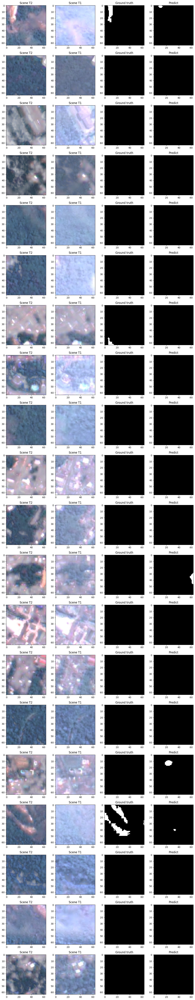

In [ ]:
# visualização das imagens de teste
def visualize_images(num_rows, random_indices):
    fig, axes = plt.subplots(num_rows, 4, figsize=(12, 3*num_rows))

    for i in range(num_rows):
        # Stack BGR NIR to RGB NIR - 8 channels -> 4 channels
        image_rgb_t1 = np.stack([patches_scenes[random_indices[i], 6, :, :], patches_scenes[random_indices[i], 5, :, :],
                                         patches_scenes[random_indices[i], 4, :, :], patches_scenes[random_indices[i], 7, :, :]], axis=2)
        image_rgb_t2 = np.stack([patches_scenes[random_indices[i], 2, :, :], patches_scenes[random_indices[i], 1, :, :],
                                        patches_scenes[random_indices[i], 0, :, :], patches_scenes[random_indices[i], 3, :, :]], axis=2)

        image_rgb_t1 = image_rgb_t1 / image_rgb_t1.max()
        image_rgb_t2 = image_rgb_t2 / image_rgb_t2.max()

        # image_rgb_t1 = patches_scenes[random_indices[i], :, :, 4:]
        # image_rgb_t2 = patches_scenes[random_indices[i], :, :, :4]

        ground_truth = patches_classes[random_indices[i]]
        predict = y_pred_argmax[random_indices[i]]

         # Cena T2
        axes[i, 0].imshow(image_rgb_t2*2)
        axes[i, 0].set_title('Scene T2')

        # Cena T1
        axes[i, 1].imshow(image_rgb_t1*2)
        axes[i, 1].set_title('Scene T1')

        # Ground truth
        axes[i, 2].imshow(ground_truth, cmap='gray')
        axes[i, 2].set_title('Ground truth')

        # Predict
        axes[i, 3].imshow(predict, cmap='gray')
        axes[i, 3].set_title('Predict')

    plt.tight_layout()
    plt.show()

# Escolha aleatoriamente algumas imagens para visualizar
num_samples = 20
random_indices = np.random.randint(0, patches_scenes.shape[0], num_samples)
print(random_indices)
#bom ... ,157,159,180,181,183,246,273,296,296,304,347,448,449,505,507,508
# random_indices = [2,25,28,29,69,70,74,95,96,109,
#                   124,128,130,138,140,149,151,153,154,155] #error: 242,243

# Visualizar as cenas e as classes lado a lado
visualize_images(num_samples, random_indices)

##11: F1-Score e Acurácia

In [ ]:
from sklearn.metrics import f1_score, classification_report, accuracy_score, confusion_matrix

# Teste separando patchs e labels do dataset
# F1-Score:
f1 = f1_score(list(patches_classes.flatten()), list(y_pred_argmax.flatten()), average='weighted')
print("F1-Score: ", f1)

# Accuracy:
acc = accuracy_score(list(patches_classes.flatten()), list(y_pred_argmax.flatten()))
print("Accuracy: ", acc)

F1-Score:  0.9822652460927789
Accuracy:  0.9846999289772728


## 12: Métrica IoU

In [ ]:
patches_scenes.shape  # transpose -> patches

(550, 8, 64, 64)

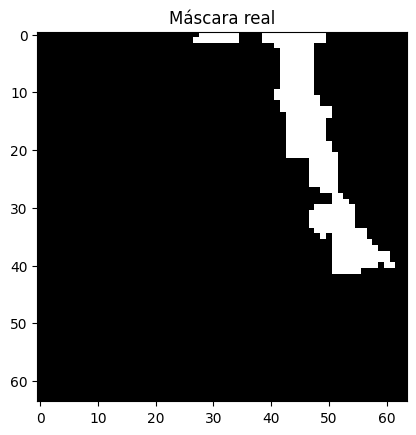

In [ ]:
id_img_teste = 236
img_teste = patches[id_img_teste]
ground_truth = patches_classes[id_img_teste]
plt.imshow(np.squeeze(ground_truth), cmap='gray')
plt.title('Máscara real');

In [ ]:
from tensorflow.keras.metrics import MeanIoU
iou_resultado = MeanIoU(num_classes = 2)

In [ ]:
img_teste.shape

(64, 64, 8)

In [ ]:
# test_img_input = np.expand_dims(img_teste, 0)
# test_img_input.shape
img_test = img_teste.reshape(1, 64, 64, 8)

In [ ]:
predictions = model.predict(img_test)

1/1 [==============================] - 1s 944ms/step


In [ ]:
predictions = tf.argmax(predictions, axis=-1)

In [ ]:
ground_truth = ground_truth.reshape(1, 64, 64, 1)

In [ ]:
ground_truth = tf.cast(ground_truth, tf.int64)

In [ ]:
iou_resultado.update_state(ground_truth, predictions)
iou = iou_resultado.result()

In [ ]:
ground_truth.shape, predictions.shape

(TensorShape([1, 64, 64, 1]), TensorShape([1, 64, 64]))

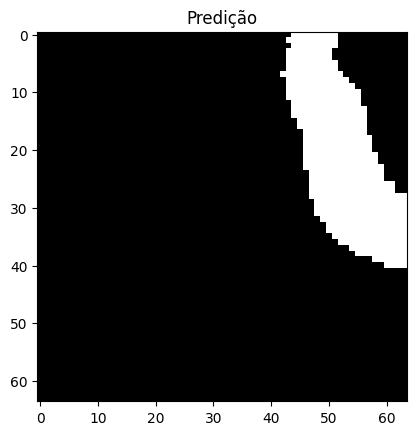

In [ ]:
plt.imshow(predictions[0], cmap='gray')
plt.title('Predição')
plt.show()

In [ ]:
iou_resultado = MeanIoU(num_classes=2)
iou_resultado.update_state(ground_truth, predictions)
iou = iou_resultado.result().numpy()
print('IoU para a imagem:', iou)

IoU para a imagem: 0.6316731


In [ ]:
import pandas as pd

valores_IoU = []
iou_resultado = MeanIoU(num_classes=2)

for idx in range(patches.shape[0]):
    img = patches[idx]
    ground_truth = patches_classes[idx]

    img_test = img.reshape(1, 64, 64, 8)

    predictions = model.predict(img_test)
    predictions = tf.argmax(predictions, axis=-1)

    ground_truth = ground_truth.reshape(1, 64, 64, 1)
    ground_truth = tf.cast(ground_truth, tf.int64)

    iou_resultado.update_state(ground_truth, predictions)
    iou = iou_resultado.result().numpy()
    valores_IoU.append(iou)

    iou_resultado.reset_states()

df = pd.DataFrame(valores_IoU, columns=["IoU"])
df = df[df.IoU != 1.0]  #sem previsao de 100%

media_IoU = df.mean().values
print("Média do IoU para " + str(len(valores_IoU)) + " imagens: ", media_IoU)

1/1 [==============================] - 0s 19ms/step
Média do IoU para 550 imagens:  [0.53496206]


In [ ]:
def calcular_iou(id_img_teste, model, patche_cena_test, patche_classe_test):
    img_teste = patche_cena_test[id_img_teste]
    ground_truth = patche_classe_test[id_img_teste]

    iou_resultado = MeanIoU(num_classes=2)

    img_test = img_teste.reshape(1, 64, 64, 8)
    predictions = model.predict(img_test)

    predictions = tf.argmax(predictions, axis=-1)

    ground_truth = ground_truth.reshape(1, 64, 64, 1)
    ground_truth = tf.cast(ground_truth, tf.int64)

    iou_resultado.update_state(ground_truth, predictions)
    iou = iou_resultado.result()

    # fig, axs = plt.subplots(1, 2, figsize=(10, 5))

    # axs[0].imshow(np.squeeze(ground_truth), cmap='gray')
    # axs[0].set_title('Máscara real')

    # axs[1].imshow(predictions[0], cmap='gray')
    # axs[1].set_title('Predição')

    # plt.show()

    print(f'IoU para a imagem {id_img_teste}: {iou}')

    return iou

def calcular_media_iou(model, patche_cena_test, patche_classe_test):
    valores_iou = []
    for id_img_teste in range(len(patche_cena_test)):
        iou = calcular_iou(id_img_teste, model, patche_cena_test, patche_classe_test)
        valores_iou.append(iou)

    media_iou = np.mean(valores_iou)
    print(f'Média do IoU para todas as imagens: {media_iou}')

# Substitua 'patche_cena_test' e 'patche_classe_test' pelos seus dados reais
calcular_media_iou(model, patches, patches_classes)


1/1 [==============================] - 0s 19ms/step
IoU para a imagem 0: 1.0
1/1 [==============================] - 0s 26ms/step
IoU para a imagem 1: 1.0
1/1 [==============================] - 0s 19ms/step
IoU para a imagem 2: 1.0
1/1 [==============================] - 0s 18ms/step
IoU para a imagem 3: 1.0
1/1 [==============================] - 0s 21ms/step
IoU para a imagem 4: 1.0
1/1 [==============================] - 0s 22ms/step
IoU para a imagem 5: 1.0
1/1 [==============================] - 0s 23ms/step
IoU para a imagem 6: 1.0
1/1 [==============================] - 0s 20ms/step
IoU para a imagem 7: 1.0
1/1 [==============================] - 0s 20ms/step
IoU para a imagem 8: 1.0
1/1 [==============================] - 0s 19ms/step
IoU para a imagem 9: 1.0
1/1 [==============================] - 0s 18ms/step
IoU para a imagem 10: 1.0
1/1 [==============================] - 0s 21ms/step
IoU para a imagem 11: 1.0
1/1 [==============================] - 0s 20ms/step
IoU para a imagem 12: 

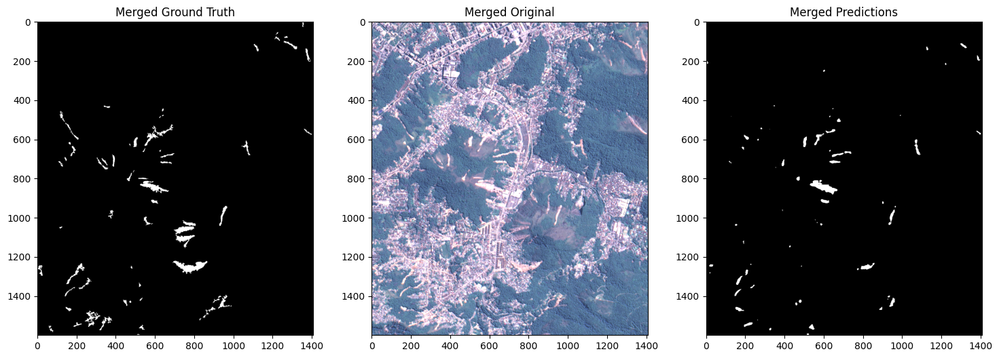

In [ ]:
# Cria imagens vazias para armazenar os patches da classe verdadeira e dos patches preditos
merged_pred_image = np.zeros((h, w))

# Tamanho dos patches
patch_size = patches_classes.shape[2]

# Vizualização dos patches_classes
for index in range(len(patches_classes)):

    # Calcula as coordenadas corretas para colocar o patche na imagem combinada
    row_start = index // (w // patch_size) * patch_size
    col_start = (index % (w // patch_size)) * patch_size

    # Preenche as imagens combinadas com os patches correspondentes
    merged_pred_image[row_start:row_start+patch_size, col_start:col_start+patch_size] += y_pred_argmax[index]


# Apresenta as imagens lado a lado
plt.figure(figsize=(18, 6))

# Imagem da classe verdadeira
plt.subplot(131)
plt.imshow(merged_true_image, cmap='gray')
plt.title('Merged Ground Truth')

# Imagem dos patches das cenas originais
plt.subplot(132)
plt.imshow(rgb_merged_scenes_image*4)
plt.title('Merged Original')

# Imagem dos patches preditos
plt.subplot(133)
plt.imshow(merged_pred_image, cmap='gray')
plt.title('Merged Predictions')

plt.show()


In [ ]:
# Sobrepor a imagem original rgb...
merged_scenes_image.shape, merged_pred_image.shape #((1600, 1408, 8), (1600, 1408))

((1600, 1408, 8), (1600, 1408))

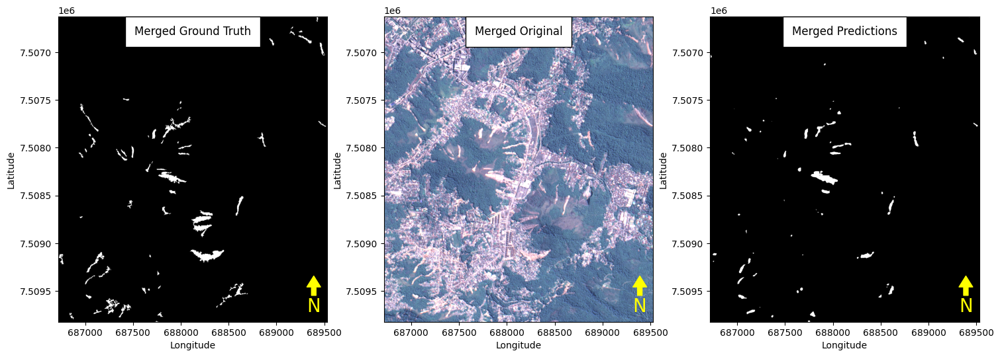

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Função para obter as coordenadas de latitude e longitude
def get_lat_lon_bounds(transform, shape):
    min_x, min_y = transform * (0, 0)
    max_x, max_y = transform * (shape[1], shape[0])
    return min_x, min_y, max_x, max_y

# Função para plotar imagem em um subplot
def plot_on_map_subplot(image, transform, title, subplot_number):
    min_x, min_y, max_x, max_y = get_lat_lon_bounds(transform, image.shape)

    plt.subplot(subplot_number)

    # Plotar a imagem raster usando matplotlib
    img = plt.imshow(image, cmap="gray", extent=[min_x, max_x, min_y, max_y])
    # plt.colorbar(img, label="Escala")

    # Personalizar rótulos e título do gráfico
    plt.xlabel("Longitude")
    plt.ylabel("Latitude")
    # plt.title(title)

    # Adicionar informações sobre a imagem
    plt.text(0.5, 0.95, title,
             fontsize=12, transform=plt.gca().transAxes, ha='center', va='center', bbox={'facecolor': 'white', 'pad': 10})

    # Adicionar a orientação do norte
    x, y, arrow_length = 0.95, 0.15, 0.1
    plt.annotate('N', xy=(x, y), xytext=(x, y - arrow_length), color='yellow',
                 arrowprops=dict(facecolor='yellow', edgecolor='yellow', width=5, headwidth=15),
                 ha='center', va='center', fontsize=20,
                 xycoords=plt.gca().transAxes)

# Criar figura para subplots
plt.figure(figsize=(18, 6))

# Exemplo de uso para cada variável merged
plot_on_map_subplot(merged_true_image, transform, 'Merged Ground Truth', 131)
plot_on_map_subplot(rgb_merged_scenes_image*4, transform, 'Merged Original', 132)
plot_on_map_subplot(merged_pred_image, transform, 'Merged Predictions', 133)

# Mostrar a figura com subplots
plt.show()


## 13: Conclusão
### A avaliação dos resultados foi melhor compreendida com a convergência do modelo de treinamento e a vizualização das segmentações dos rótudos feitas pelo algoritmo, assim verificando os rótulos verdadeiros separados do conjunto de teste, portanto generalizados. Em trabalhos futuros, deverão ser realizadas comparações com arquiteturas de modelos como a DeepLabV3 com utilização de mais classes, como o tamanho dos deslizamentos. Além disso, o processamento das imagens bitemporais deverão ser mais precisas, com registro (sem deslocamento) e um melhor segmento das máscaras de deslizamentos com a biblioteca RSGISLIb [3], considerando os mapas produzidos por especialistas da iniciativa Charter, como a classe verdade [4].

## Referências
  - [1] [Python for Geosciences: Raster Merging, Clipping and Reprojection with Rasterio](https://medium.com/analytics-vidhya/python-for-geosciences-raster-merging-clipping-and-reprojection-with-rasterio-9f05f012b88a)
  - [2] [Notebook WorkCAP Hackathon 2022](https://www.kaggle.com/code/grupohackaton2022/hackathon-notebook)
  - [3] [RSGISLib Image Segmentation Module](http://rsgislib.org/rsgislib_segmentation.html)
  - [4] [Disasters Charter](https://disasterscharter.org/web/guest/activations/-/article/landslide-in-brazil-activation-758-)